# Generic Nearest Neighborhood Analysis

In [1]:
import pandas as pd
import numpy as np
from sklearn.neighbors import NearestNeighbors
import time
import sys
import matplotlib.pyplot as plt
import math
import os

from sklearn.cluster import MiniBatchKMeans
import seaborn as sns
import scanpy as sc

def get_windows(job,n_neighbors):
    start_time,idx,tissue_name,indices = job
    job_start = time.time()
    
    print ("Starting:", str(idx+1)+'/'+str(len(exps)),': ' + exps[idx])

    tissue = tissue_group.get_group(tissue_name)
    to_fit = tissue.loc[indices][[X,Y]].values

    fit = NearestNeighbors(n_neighbors=n_neighbors).fit(tissue[[X,Y]].values)
    m = fit.kneighbors(to_fit)

    #sort_neighbors
    args = m[0].argsort(axis = 1)
    add = np.arange(m[1].shape[0])*m[1].shape[1]
    sorted_indices = m[1].flatten()[args+add[:,None]]

    neighbors = tissue.index.values[sorted_indices]
   
    end_time = time.time()
   
    print ("Finishing:", str(idx+1)+"/"+str(len(exps)),": "+ exps[idx],end_time-job_start,end_time-start_time)
    return neighbors.astype(np.int32)


In [2]:
#Choose this information and input based on above
ks = [100] # k=5 means it collects 5 nearest neighbors for each center cell
path_to_data = '/Volumes/GoogleDrive/My Drive/Research/CRUK/CellAtlas/21_11_17_CellAtlas_Neighborhoods.csv'

X = 'x'
Y = 'y'
reg = 'unique_region'
file_type = 'csv'

cluster_col = 'neigh_name'
cellhier_path = '/Users/jwhickey/Documents/Stanford/python_code/cellhier'
keep_cols = [X,Y,reg,cluster_col]
save_path = '/Users/jwhickey/Nolan Lab Dropbox/John Hickey/CRUK/Cell_Atlas/analysis/'

# Data Preprocessing

##########################

In [3]:
#Import Data
n_neighbors = max(ks)
sys.path.append(cellhier_path)
from cellhier.general import *

cells = pd.read_csv(path_to_data, index_col=0)
cells = pd.concat([cells,pd.get_dummies(cells[cluster_col])],1)
sum_cols = cells[cluster_col].unique()
values = cells[sum_cols].values

/Users/jwhickey/opt/anaconda3/envs/scanpy/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
#Get each region
tissue_group = cells[[X,Y,reg]].groupby(reg)
exps = list(cells[reg].unique())
tissue_chunks = [(time.time(),exps.index(t),t,a) for t,indices in tissue_group.groups.items() for a in np.array_split(indices,1)] 
tissues = [get_windows(job,n_neighbors) for job in tissue_chunks]

Starting: 1/32 : E08_reg001
Finishing: 1/32 : E08_reg001 0.1973729133605957 0.19962501525878906
Starting: 2/32 : E08_reg002
Finishing: 2/32 : E08_reg002 0.08285212516784668 0.2889900207519531
Starting: 3/32 : E08_reg003
Finishing: 3/32 : E08_reg003 0.09861087799072266 0.3927321434020996
Starting: 4/32 : E08_reg004
Finishing: 4/32 : E08_reg004 0.21249103546142578 0.6072220802307129
Starting: 5/32 : E08_reg005
Finishing: 5/32 : E08_reg005 0.15224409103393555 0.7628180980682373
Starting: 6/32 : E08_reg006
Finishing: 6/32 : E08_reg006 0.21198701858520508 0.977524995803833
Starting: 7/32 : E08_reg007
Finishing: 7/32 : E08_reg007 0.12532925605773926 1.1057710647583008
Starting: 8/32 : E11_reg001
Finishing: 8/32 : E11_reg001 0.15981101989746094 1.2707350254058838
Starting: 9/32 : E11_reg002
Finishing: 9/32 : E11_reg002 0.273759126663208 1.5468902587890625
Starting: 10/32 : E11_reg003
Finishing: 10/32 : E11_reg003 0.142333984375 1.6937940120697021
Starting: 11/32 : E11_reg004
Finishing: 11/32 

In [5]:
#Loop over k to compute neighborhoods
out_dict = {}
for k in ks:
    for neighbors,job in zip(tissues,tissue_chunks):

        chunk = np.arange(len(neighbors))#indices
        tissue_name = job[2]
        indices = job[3]
        window = values[neighbors[chunk,:k].flatten()].reshape(len(chunk),k,len(sum_cols)).sum(axis = 1)
        out_dict[(tissue_name,k)] = (window.astype(np.float16),indices)
        
windows = {}
for k in ks:
   
    window = pd.concat([pd.DataFrame(out_dict[(exp,k)][0],index = out_dict[(exp,k)][1].astype(int),columns = sum_cols) for exp in exps],0)
    window = window.loc[cells.index.values]
    window = pd.concat([cells[keep_cols],window],1)
    windows[k] = window

In [6]:
#Fill in based on above
k = 100
n_neighborhoods = 30
neighborhood_name = "community"+str(k)
k_centroids = {}

In [7]:
#producing what to plot
windows2 = windows[k]
windows2[cluster_col] = cells[cluster_col]

km = MiniBatchKMeans(n_clusters = n_neighborhoods,random_state=0)

labels = km.fit_predict(windows2[sum_cols].values)
k_centroids[k] = km.cluster_centers_
cells[neighborhood_name] = labels

E08_reg001


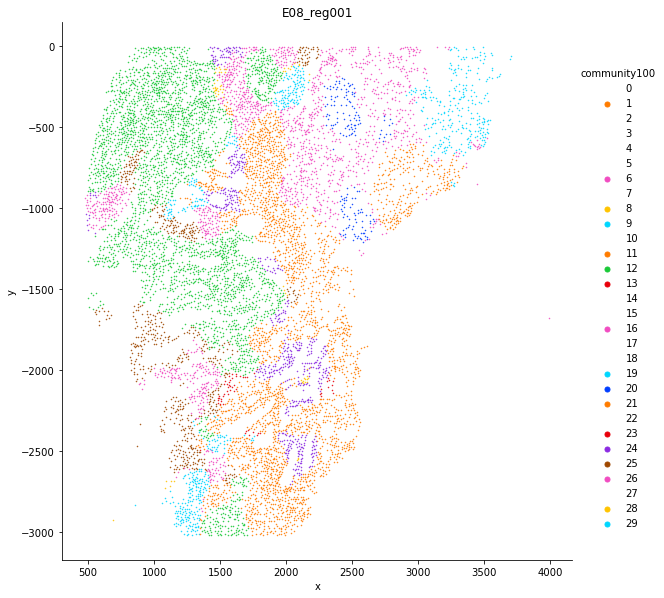

E08_reg002


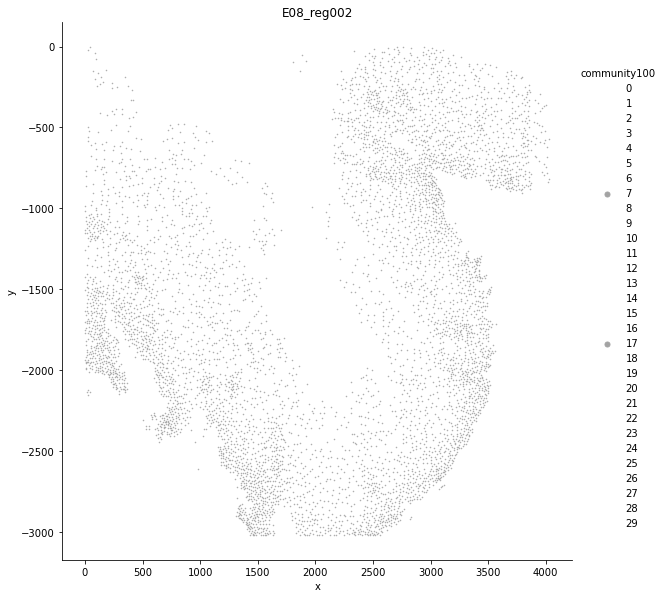

E08_reg003


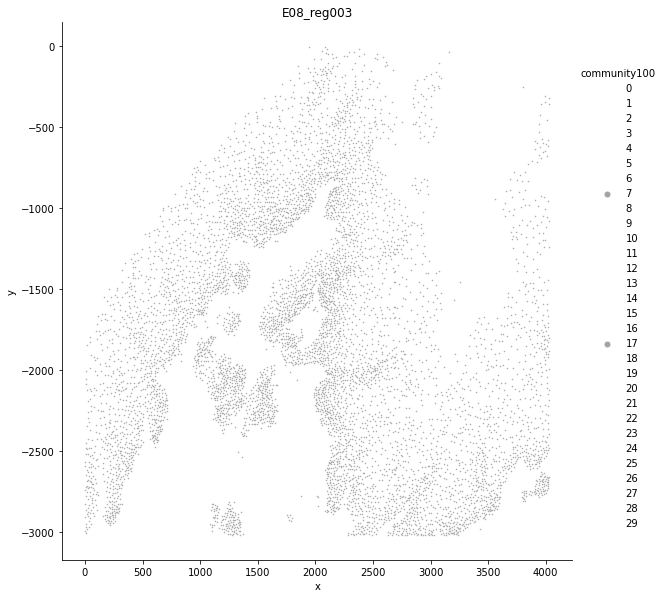

E08_reg004


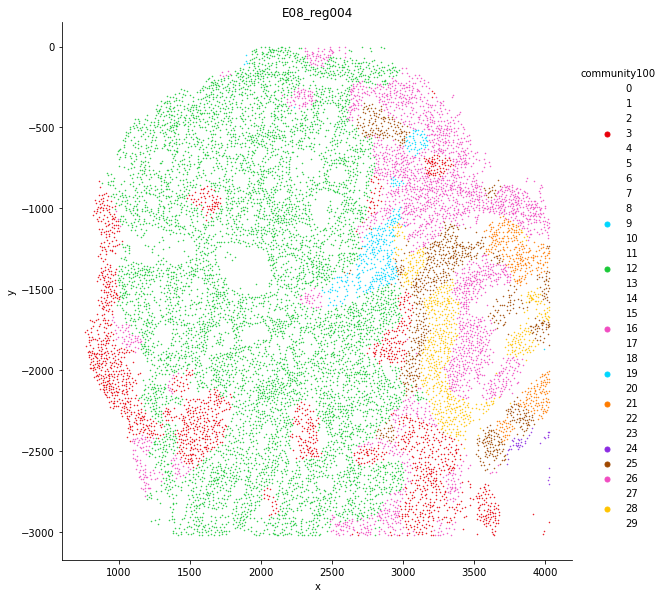

E08_reg005


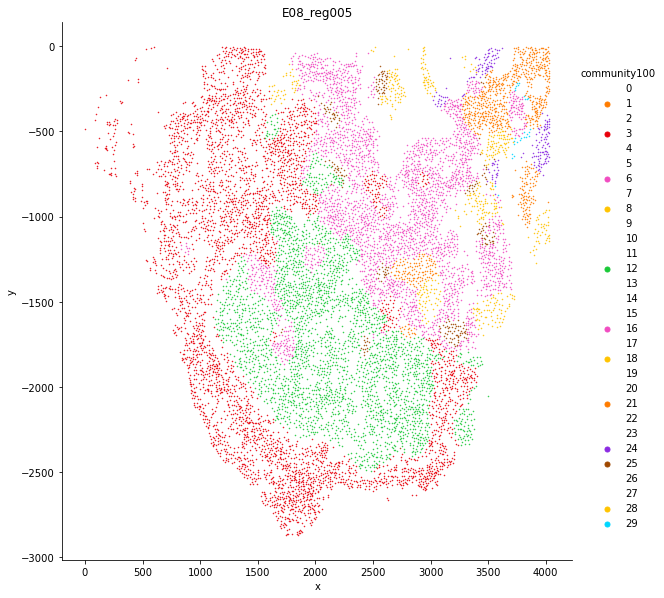

E08_reg006


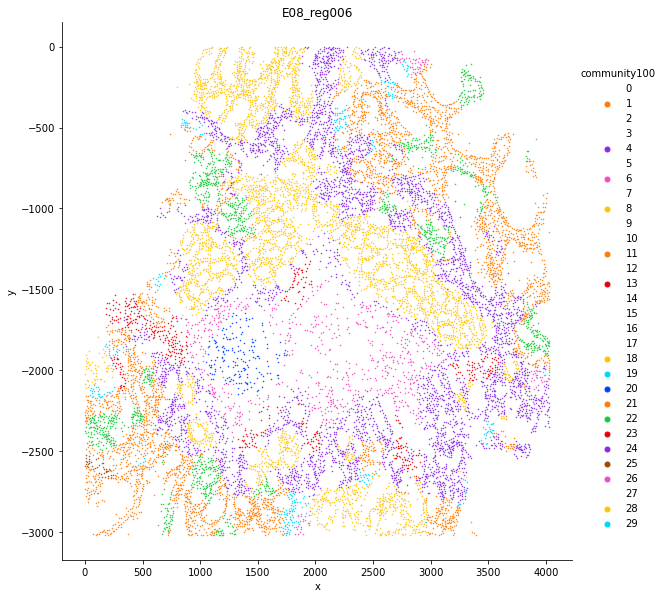

E08_reg007


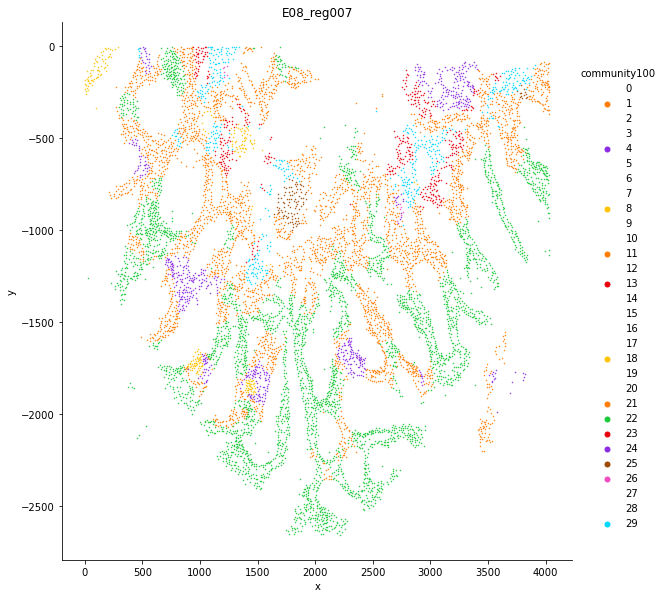

E11_reg001


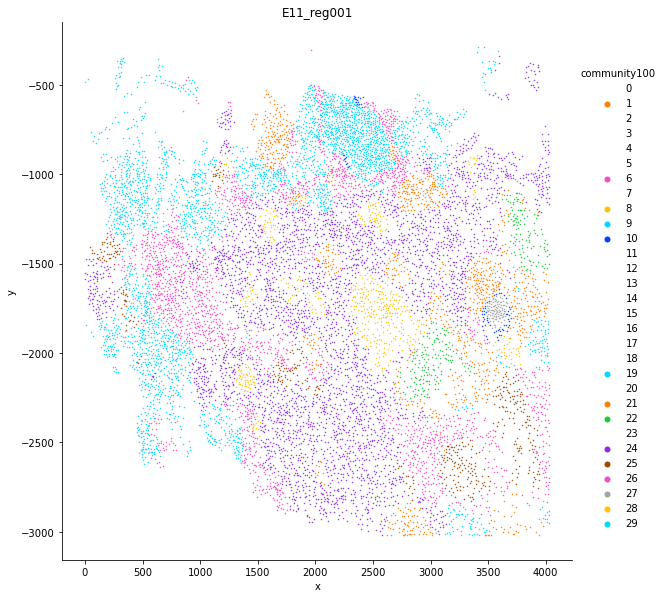

E11_reg002


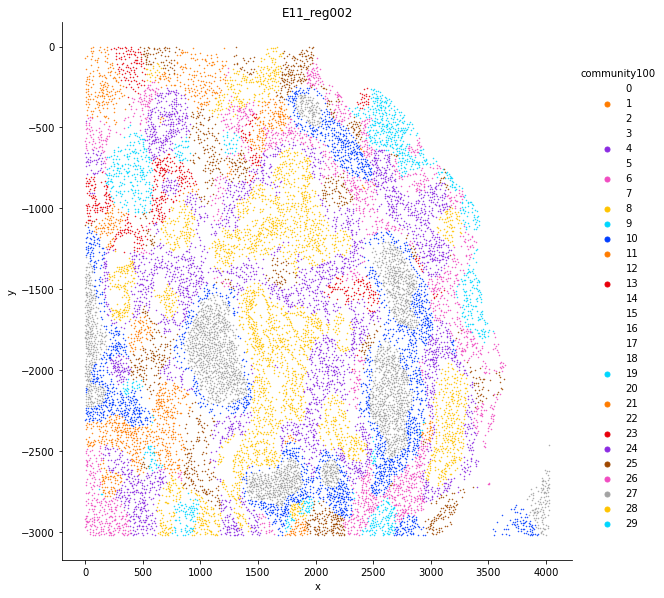

E11_reg003


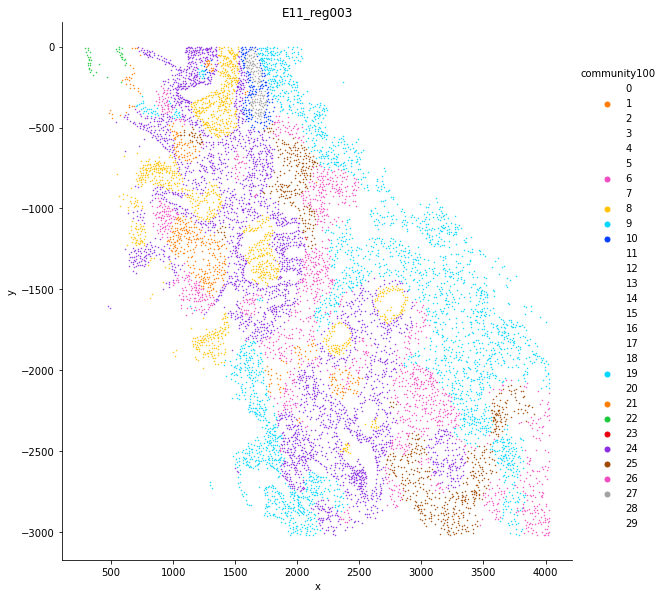

E11_reg004


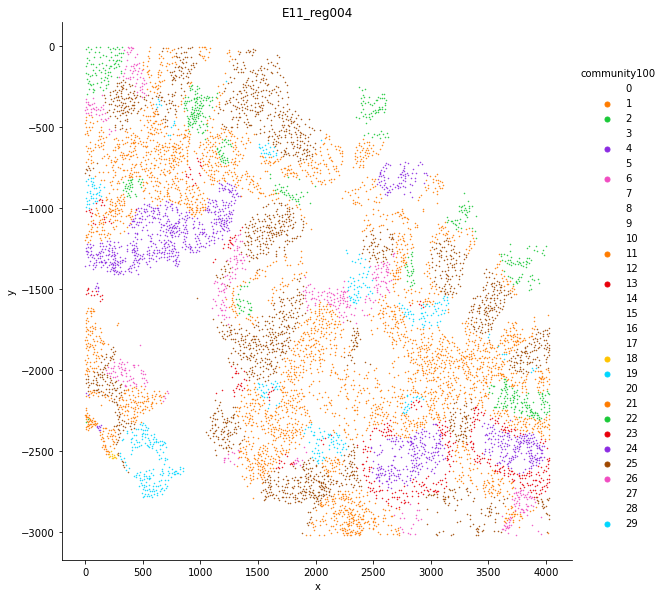

E11_reg005


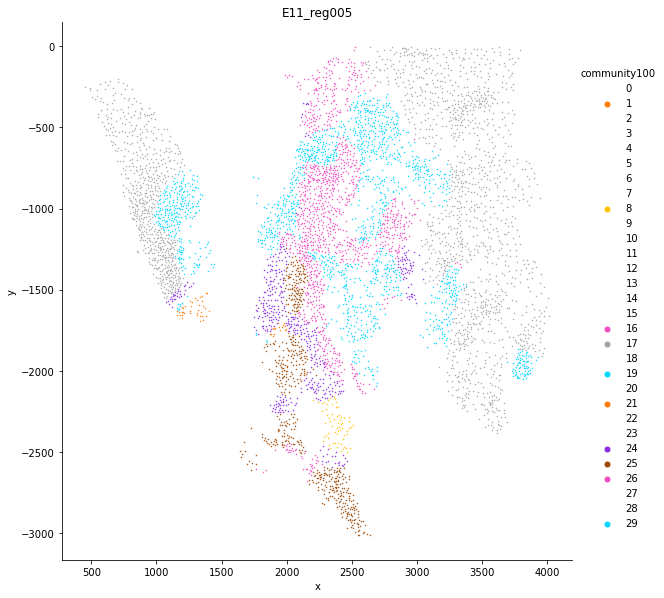

E11_reg006


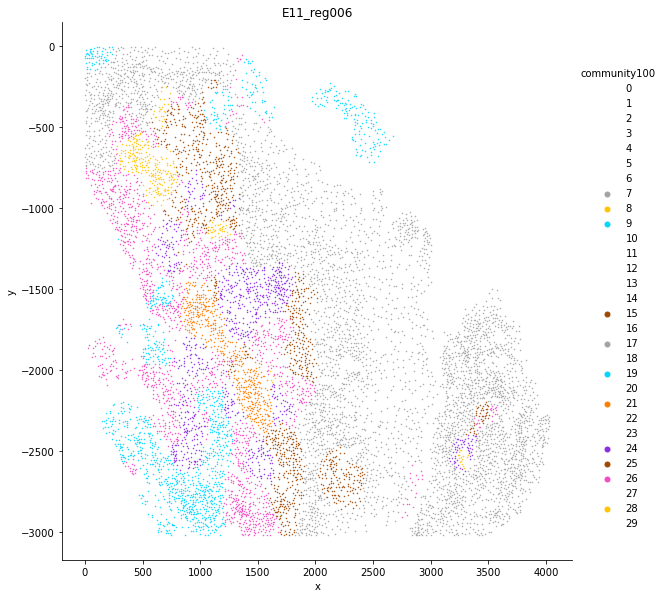

E18_reg001


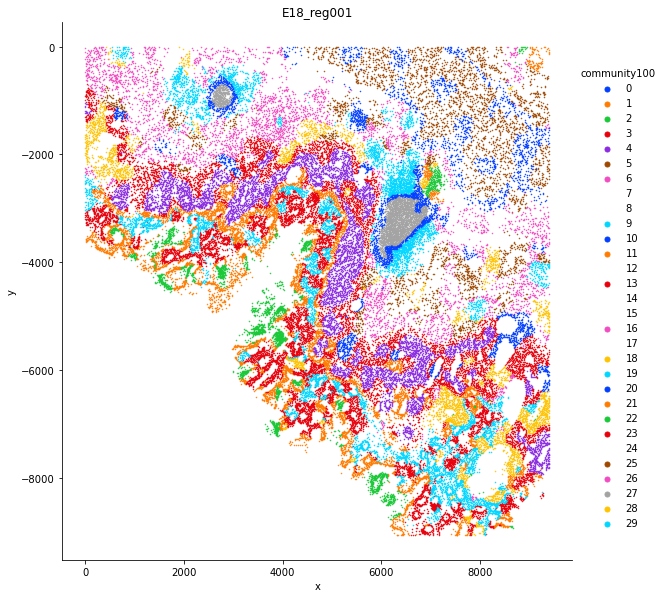

E18_reg002


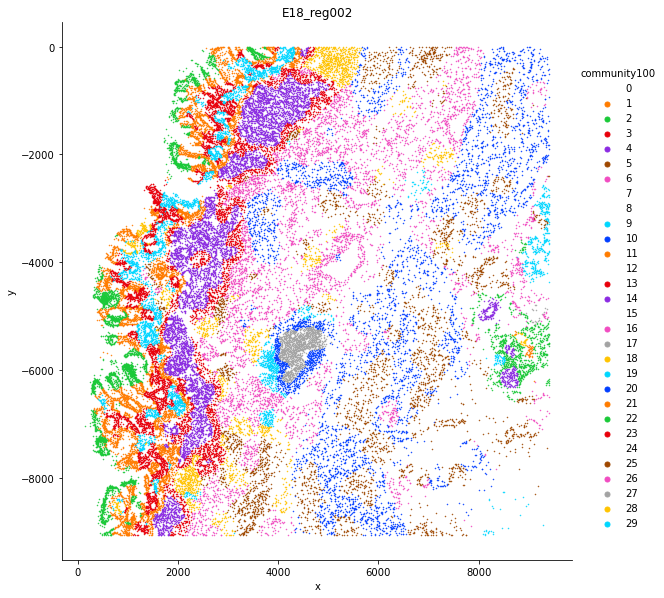

E18_reg003


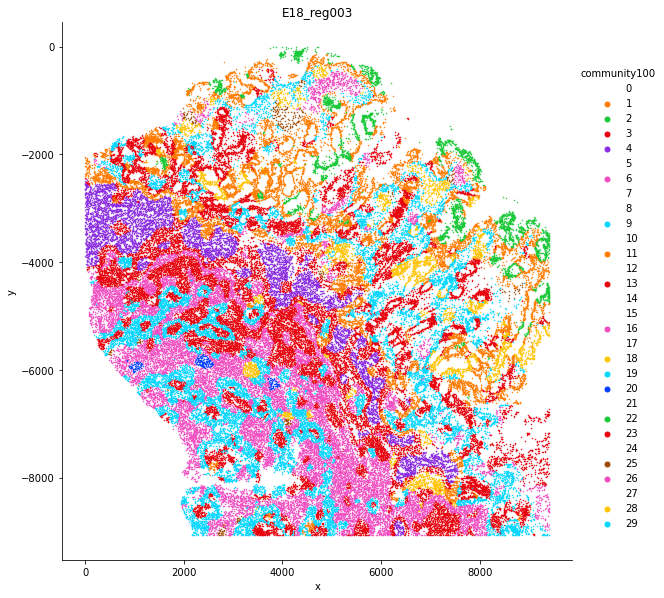

E18_reg004


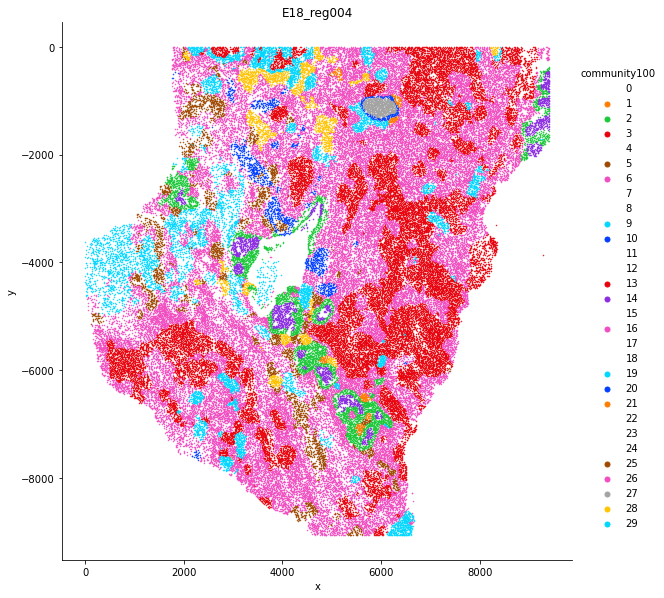

E17_reg001


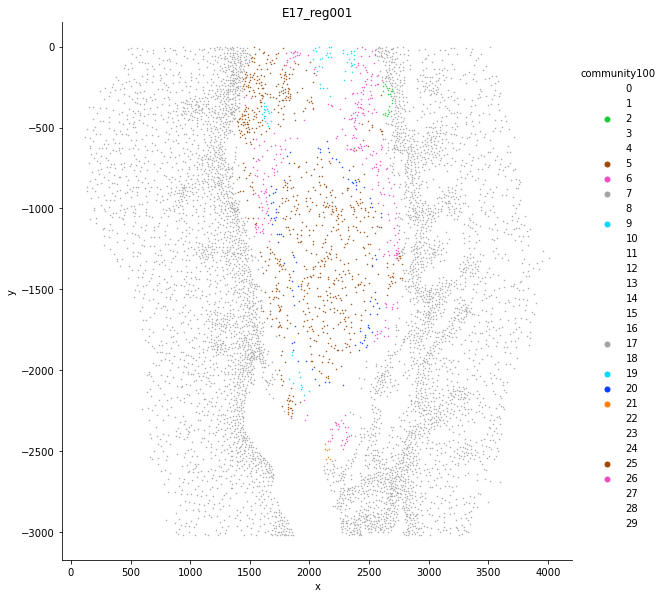

E17_reg002


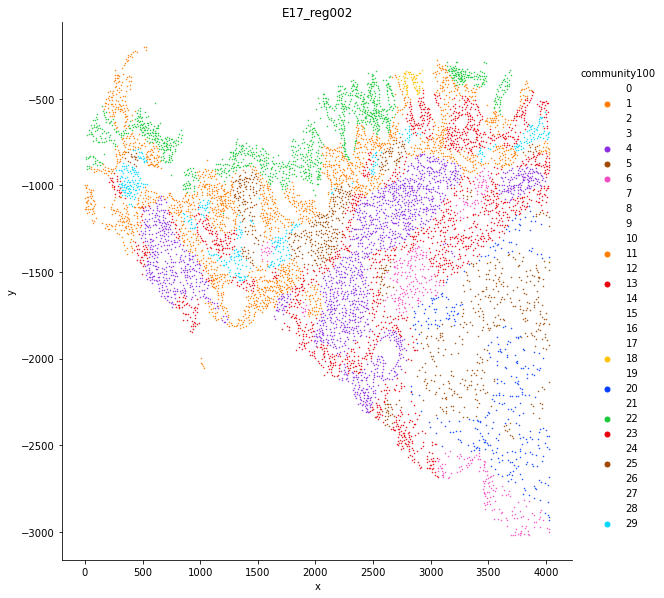

E17_reg003


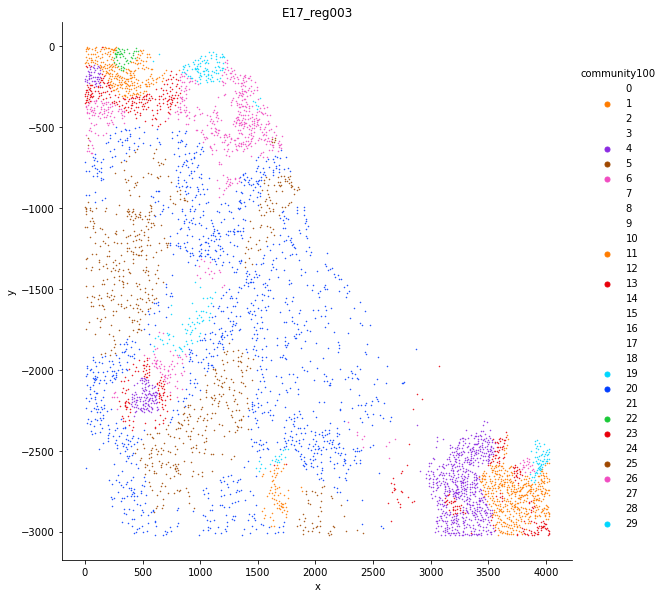

E17_reg004


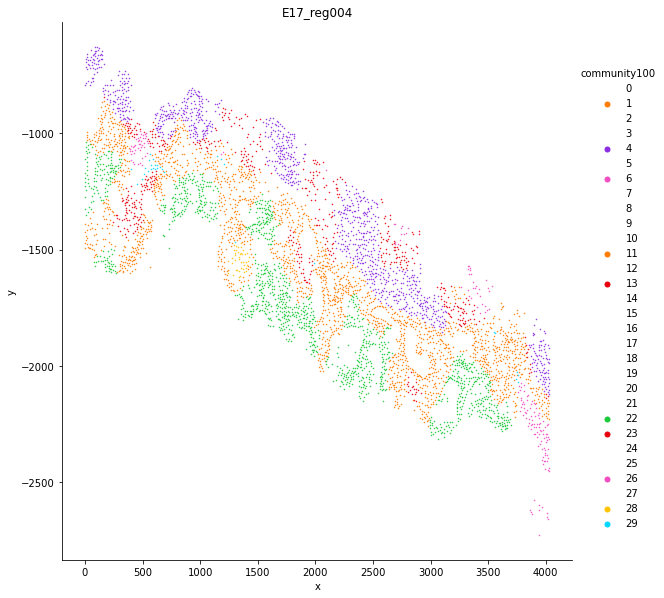

E17_reg005


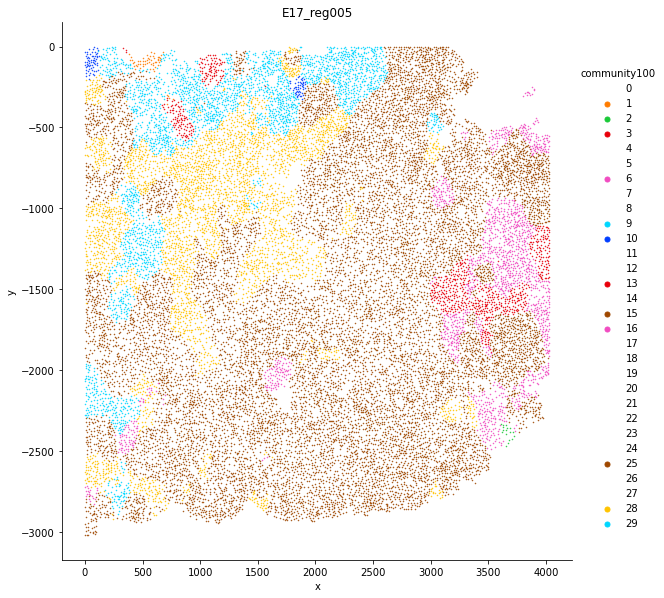

E17_reg006


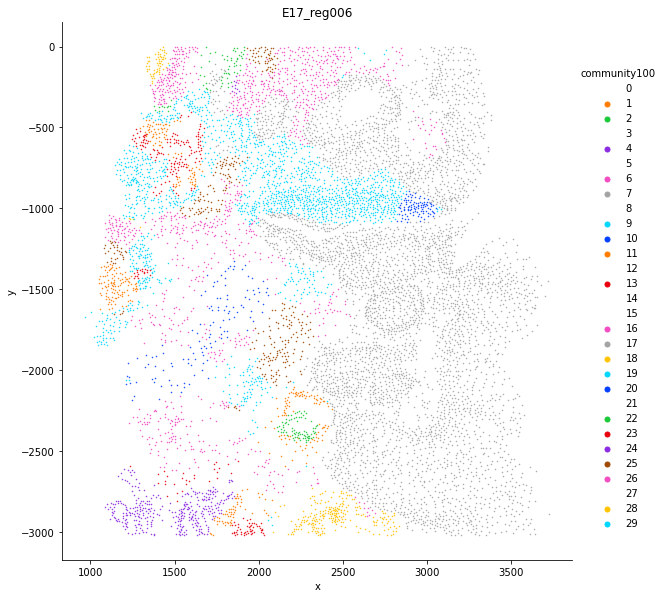

E19_reg001


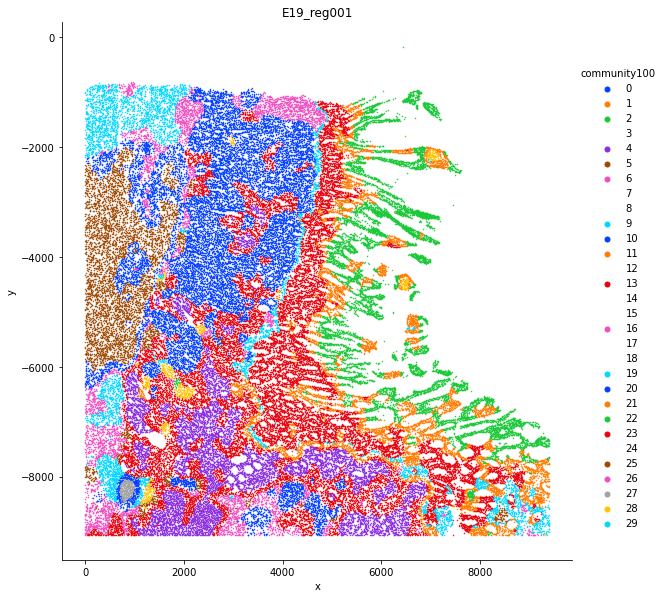

E19_reg002


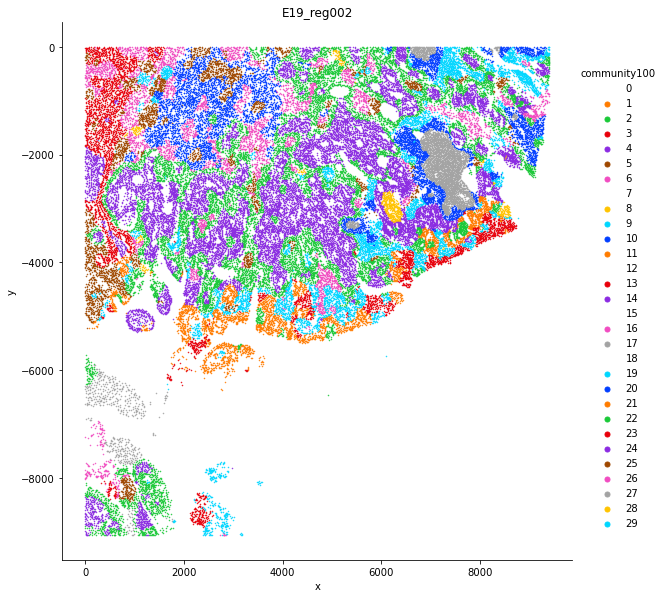

E19_reg003


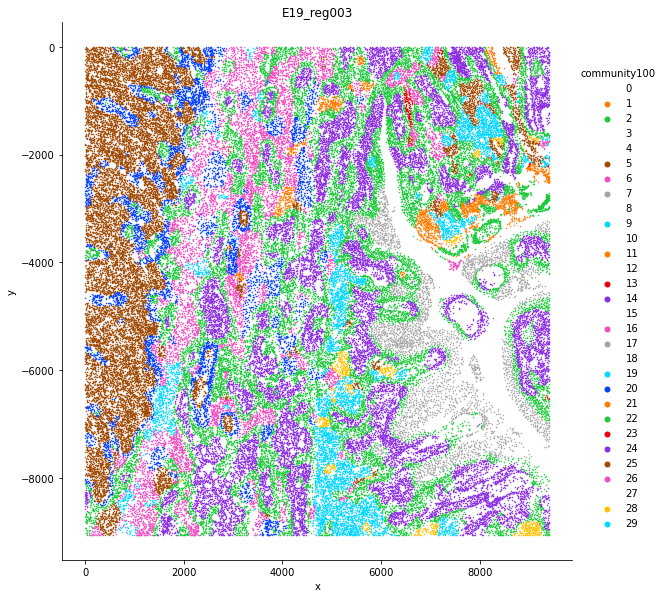

E19_reg004


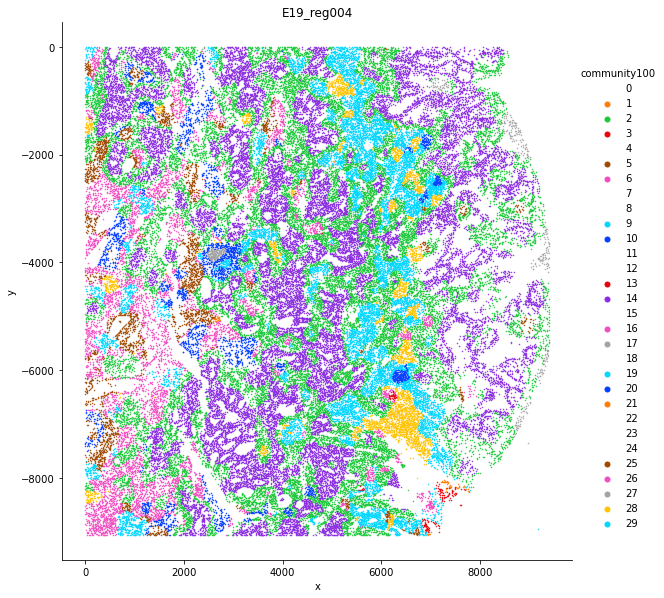

E12_reg001


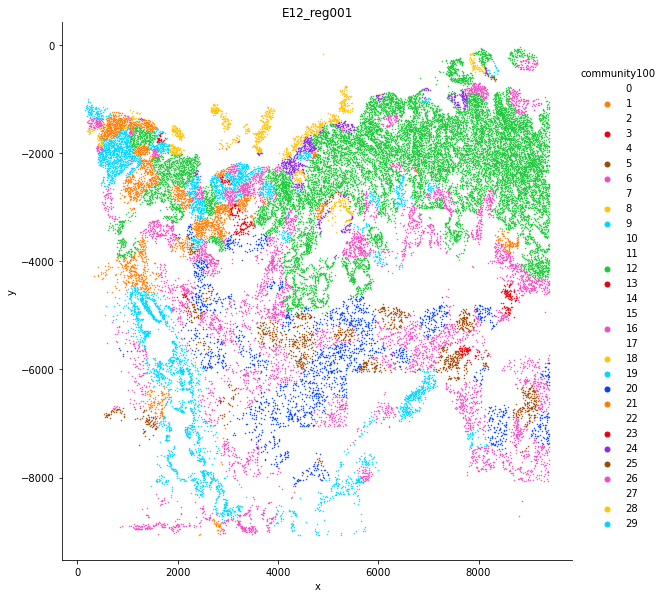

E12_reg002


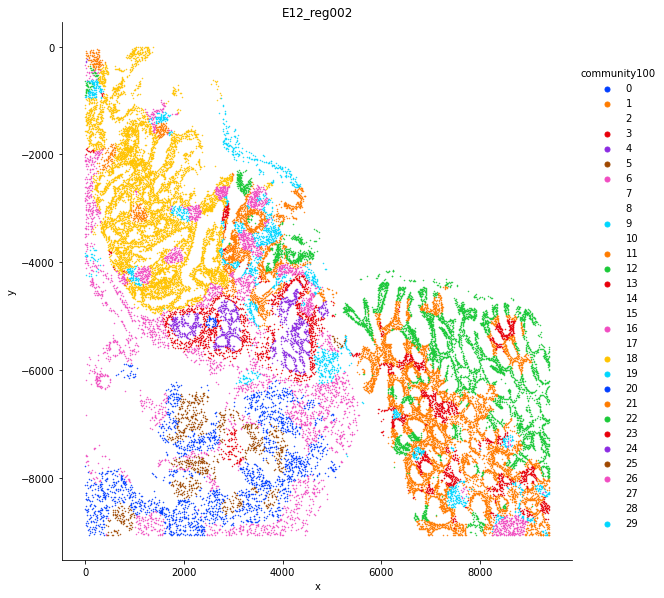

E12_reg003


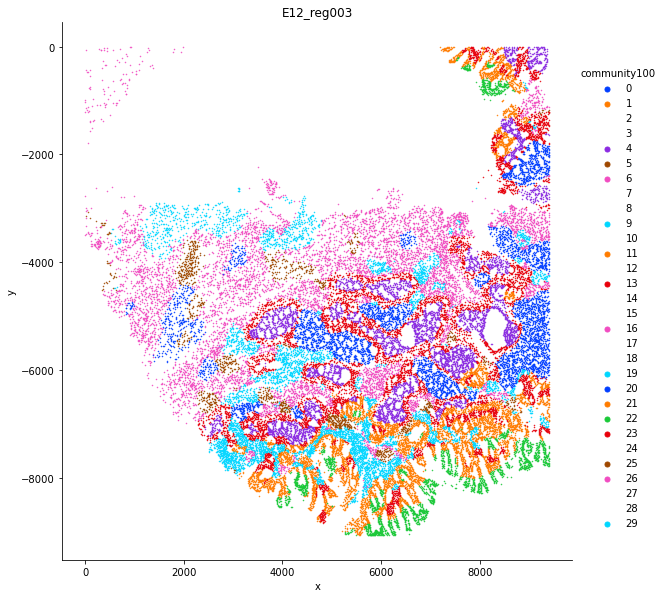

E12_reg004


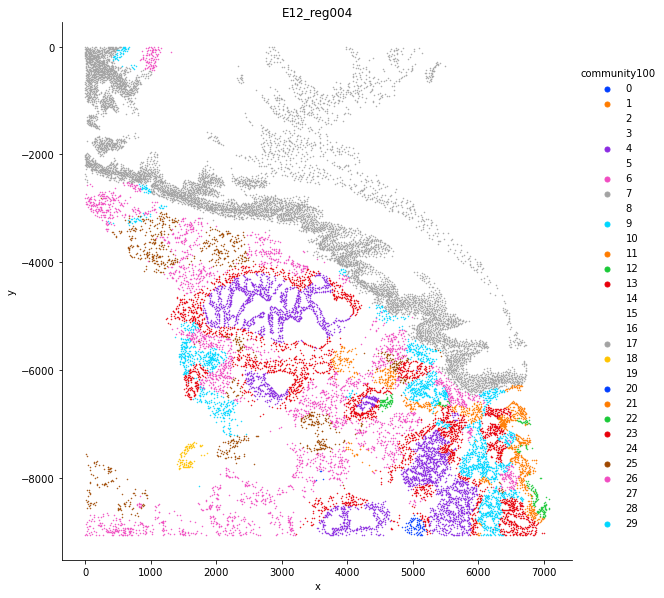

E12_reg005


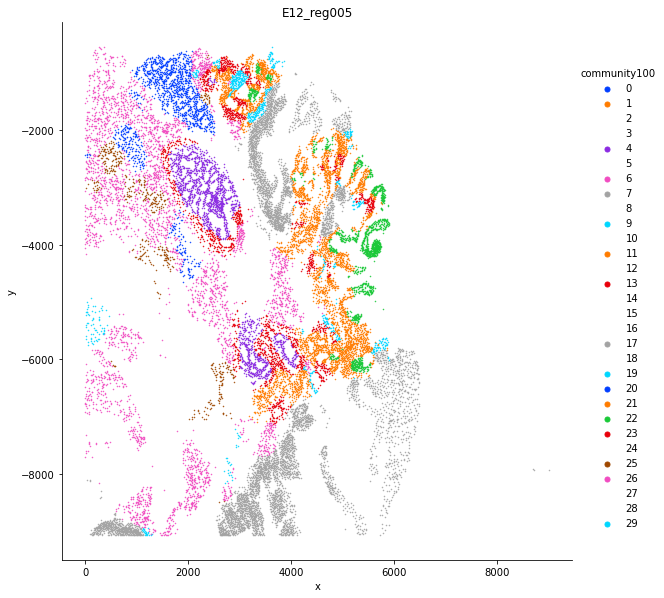

In [8]:
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
figs = catplot(cells,X = X,Y=Y,exp = reg,
               hue = 'community'+str(k),invert_y=True,size = 1,figsize=8)

In [ ]:
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
figs = catplot(cells.loc[cells.community100.isin([19,25,26,21])],X = X,Y=Y,exp = reg,
               hue = 'community'+str(k),invert_y=True,size = 1,figsize=8)

In [ ]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc.iloc[[19,25,26,21],:], vmin =-3,vmax = 3,cmap = 'bwr',figsize=(10,5))
#s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

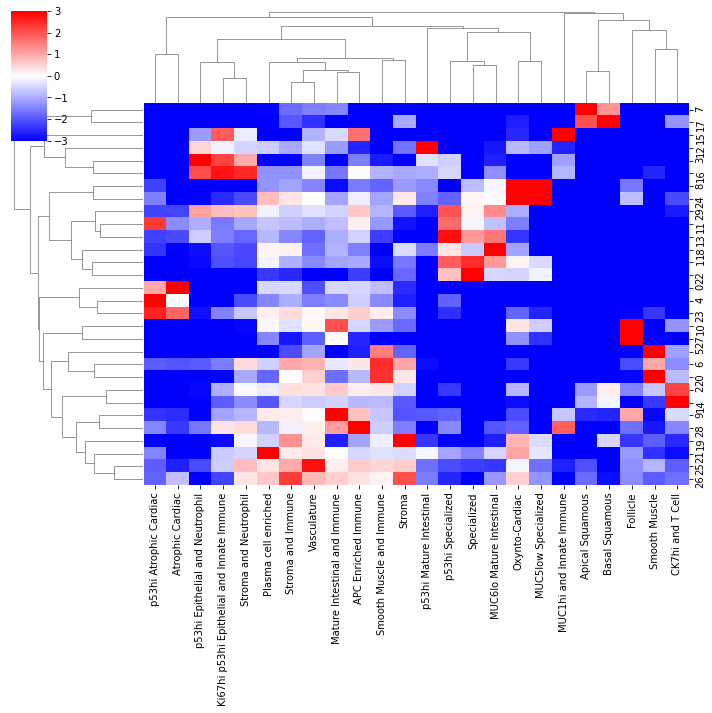

In [9]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
k_to_plot = k
niche_clusters = (k_centroids[k_to_plot])
tissue_avgs = values.mean(axis = 0)
fc = np.log2(((niche_clusters+tissue_avgs)/(niche_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc = pd.DataFrame(fc,columns = sum_cols)
s=sns.clustermap(fc, vmin =-3,vmax = 3,cmap = 'bwr', figsize=(10,10))
#s.savefig(save_path+"celltypes_perniche_"+"_"+str(k)+".png", dpi=600)

In [10]:
# n_conversion_20 = {
#     0: 'Atrophic Cardiac',
#     1: 'Basal Inflamed Stroma',
#     2: 'Specialized',
#     3: 'Inflamed Tumor',
#     4: 'CK7hi and T cell',
#     5: 'p53hi Mature Intestinal',
#     6: 'Atrophic Cardiac',
#     7: 'Squamous',
#     8: 'Smooth Muscle',
#     9: 'Inflamed Mature Intestinal',
   
#     10: 'Inflamed Tumor',
#     11: 'Follicle & Mature Intestinal',
#     12: 'Specialized',
#     13: 'Oxnto-Cardiac',
#     14: 'Atrophic Cardiac Inflamed',
#     15: 'Follicle & Mature Intestinal',
#     16: 'MUC1+ Inflamed Tumor',
#     17: 'Smooth Muscle',
#     18: 'Inflamed Stroma',
#     19: 'Specialized',
# }
# cells['community']=cells['community100'].map(n_conversion_20)
# #modify figure size aesthetics for each neighborhood
# plt.rcParams["legend.markerscale"] = 10
# figs = catplot(cells,X = X,Y=Y,exp = reg,
#                hue = 'community',invert_y=True,size = 1,figsize=8)

In [12]:
n_conversion_30 = {
    0: 'Atrophic Cardiac',
    1: 'Specialized',
    2: 'CK7hi and T cell',
    3: 'Inflamed Dysplasia',
    4: 'Atrophic Cardiac',
    5: 'Smooth Muscle',
    6: 'Smooth Muscle',
    7: 'Squamous',
    8: 'Oxnto-Cardiac/Specialized',
    9: 'Inflamed Mature Intestinal',
   
    10: 'Follicle',
    11: 'Specialized',
    12: 'Inflamed Dysplasia',
    13: 'Specialized',
    14: 'CK7hi and T cell',
    15: 'Inflamed Dysplasia',
    16: 'Inflamed Dysplasia',
    17: 'Squamous',
    18: 'Specialized',
    19: 'Inflamed Stroma',
   
    20: 'Smooth Muscle',
    21: 'Inflamed Stroma',
    22: 'Specialized',
    23: 'Atrophic Cardiac',
    24: 'Oxnto-Cardiac/Specialized',
    25: 'Inflamed Stroma',
    26: 'Inflamed Stroma',
    27: 'Follicle',
    28: 'Inflamed Mature Intestinal',
    29: 'Specialized',
}
cells['community']=cells['community100'].map(n_conversion_30)
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
# figs = catplot(cells,X = X,Y=Y,exp = reg,
#                hue = 'community',invert_y=True,size = 1,figsize=8)

In [ ]:
figs = catplot(cells,X = X,Y=Y,exp = reg,
               hue = 'community',invert_y=True,size = 3,figsize=5)

In [ ]:
list(cells['community'].unique())

E08_reg001


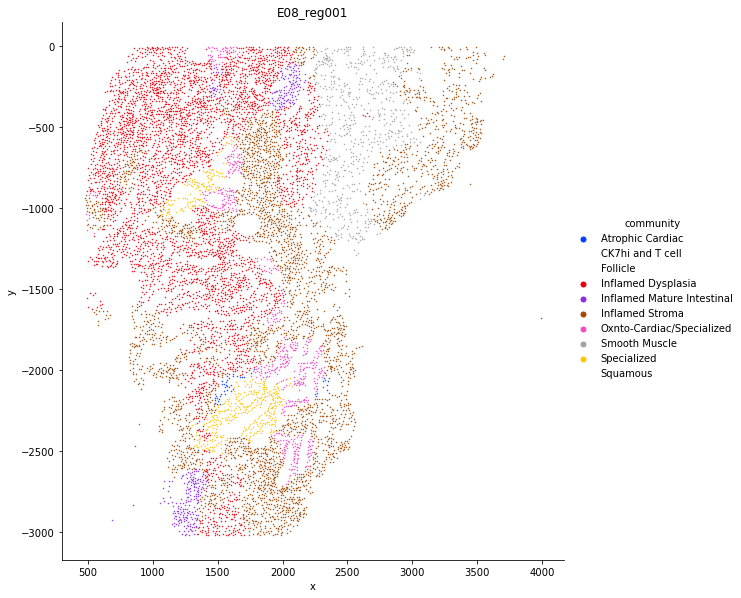

E08_reg002


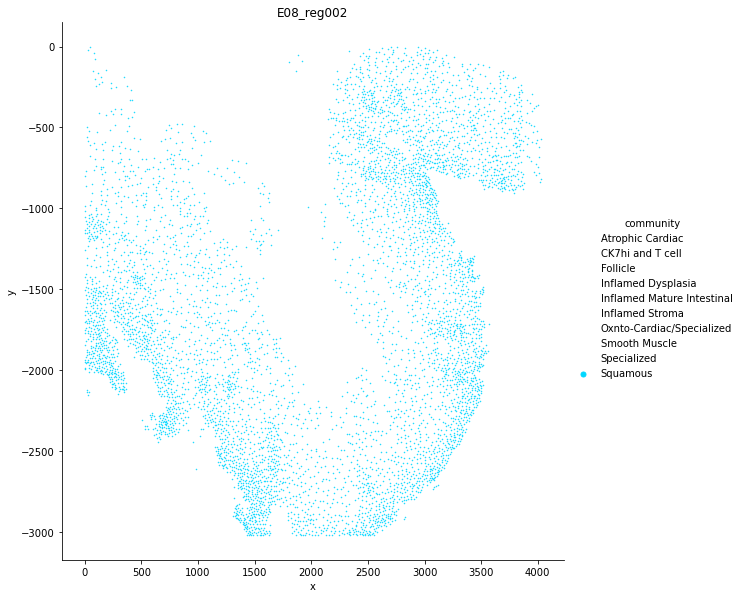

E08_reg003


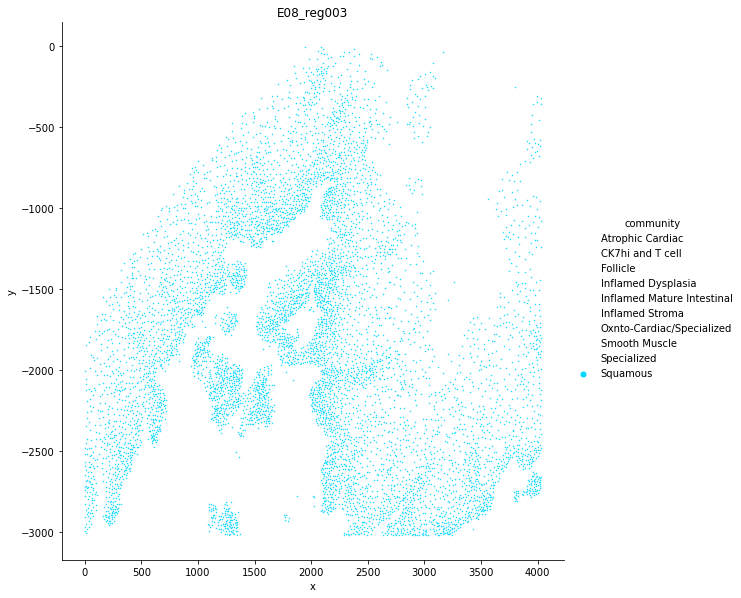

E08_reg004


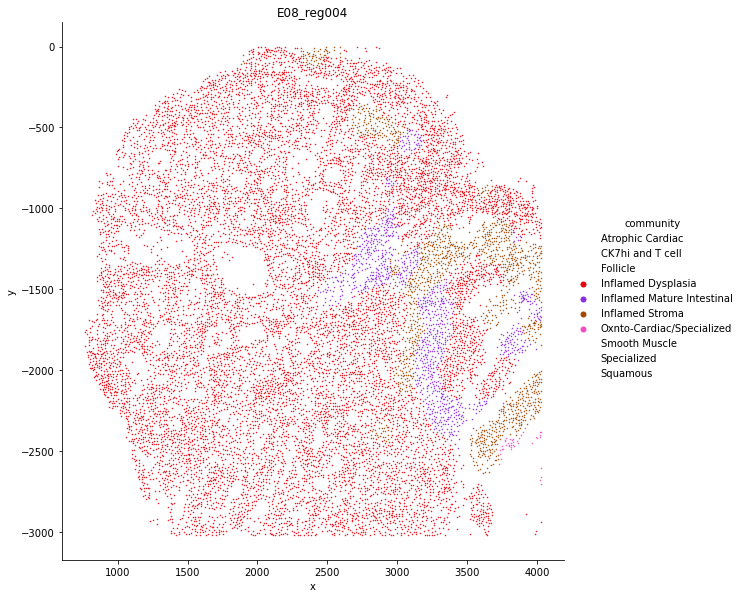

E08_reg005


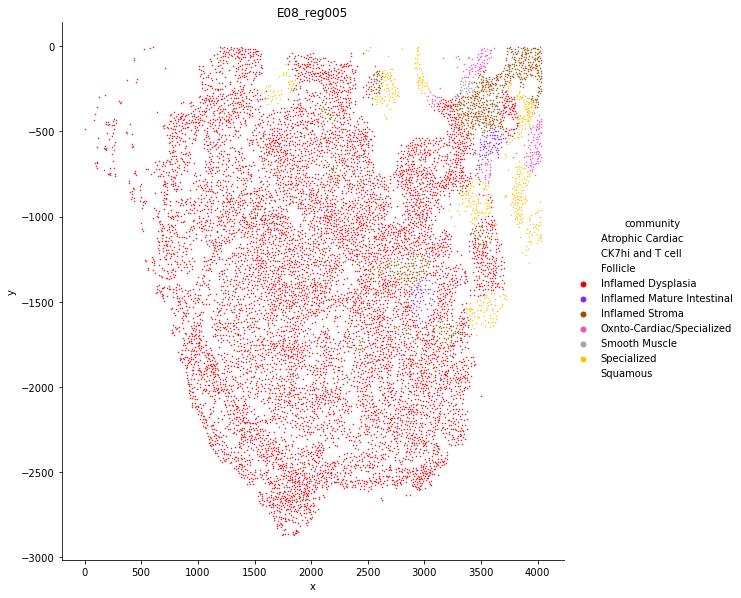

E08_reg006


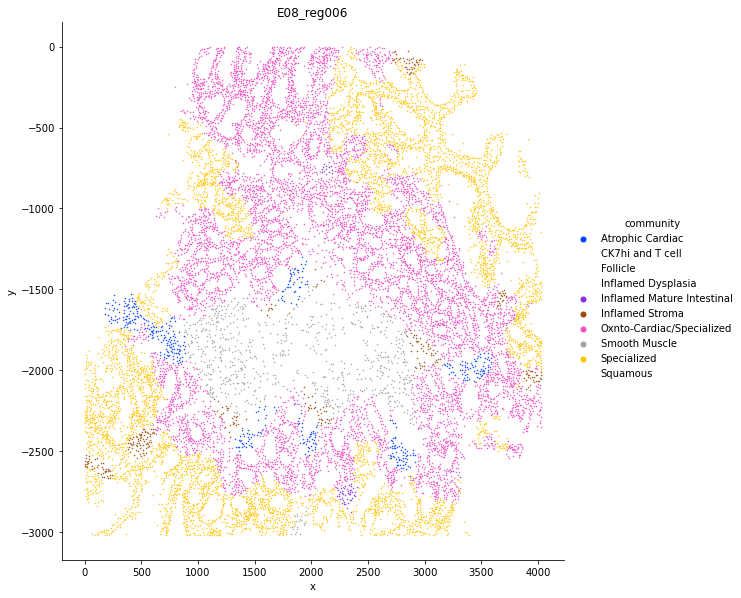

E08_reg007


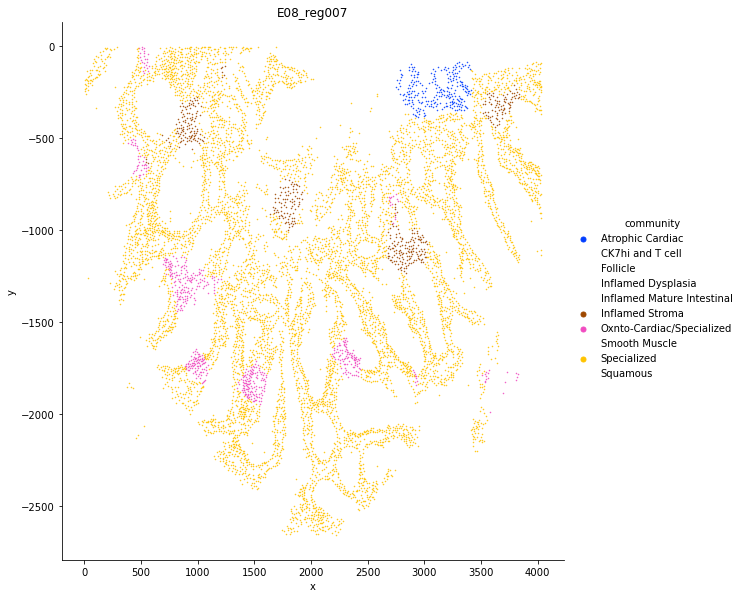

E11_reg001


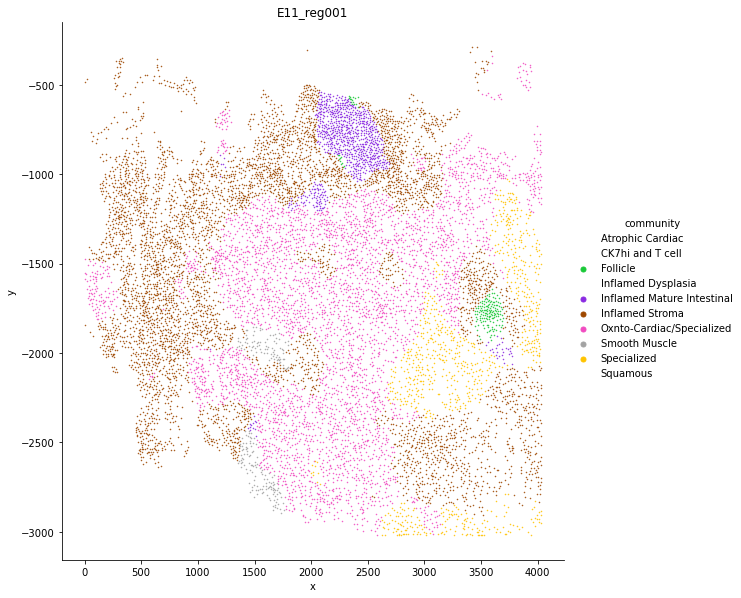

E11_reg002


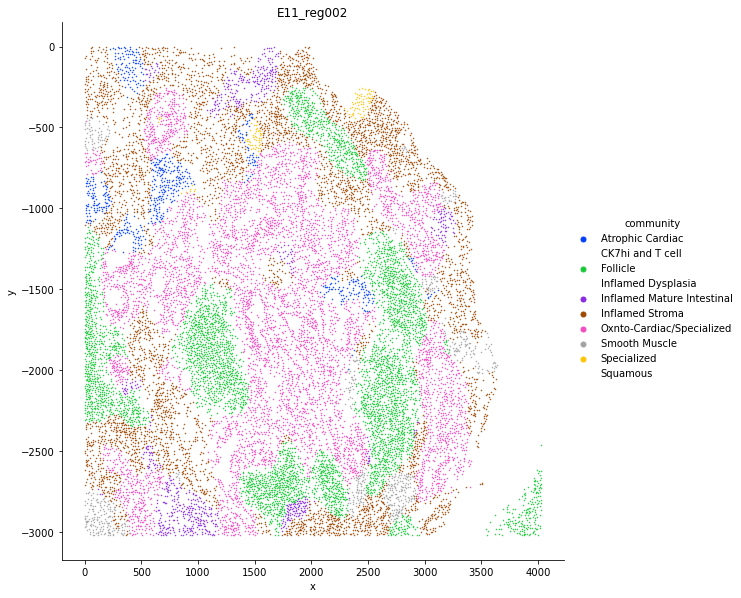

E11_reg003


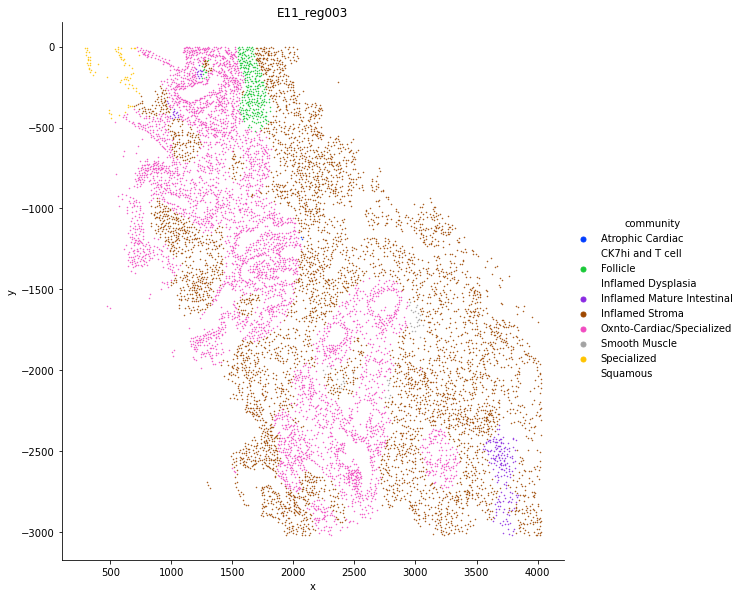

E11_reg004


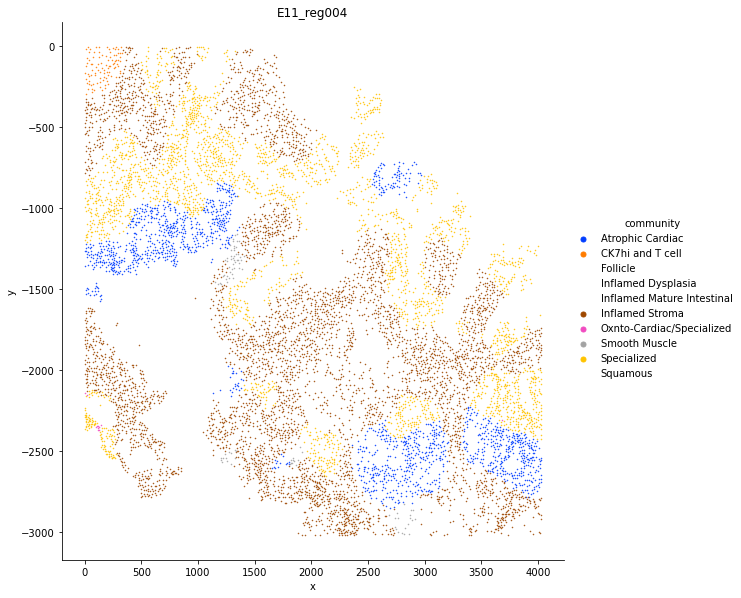

E11_reg005


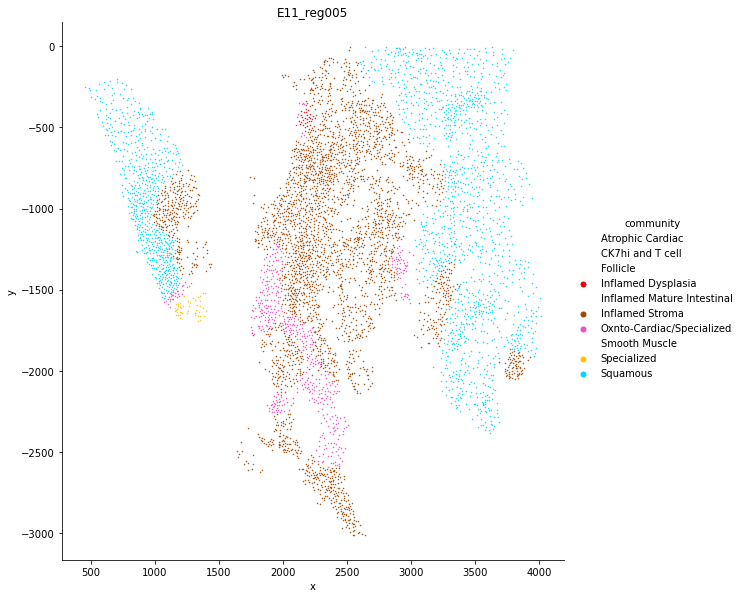

E11_reg006


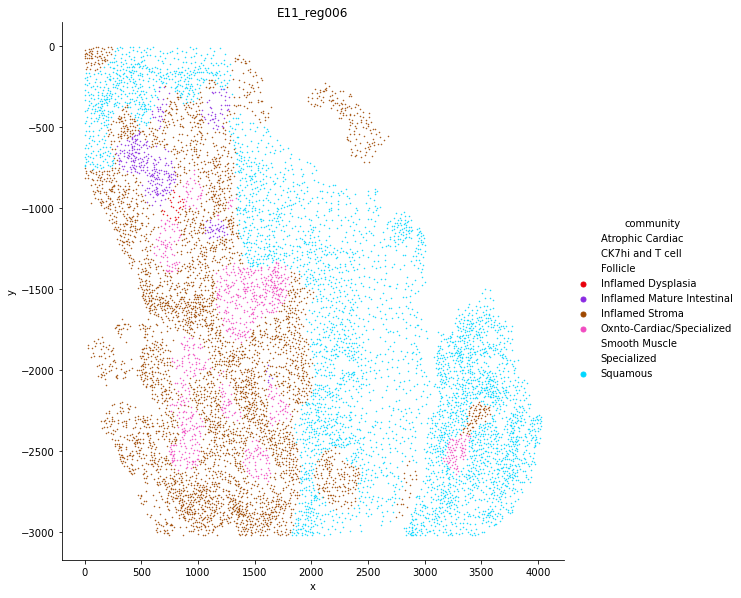

E18_reg001


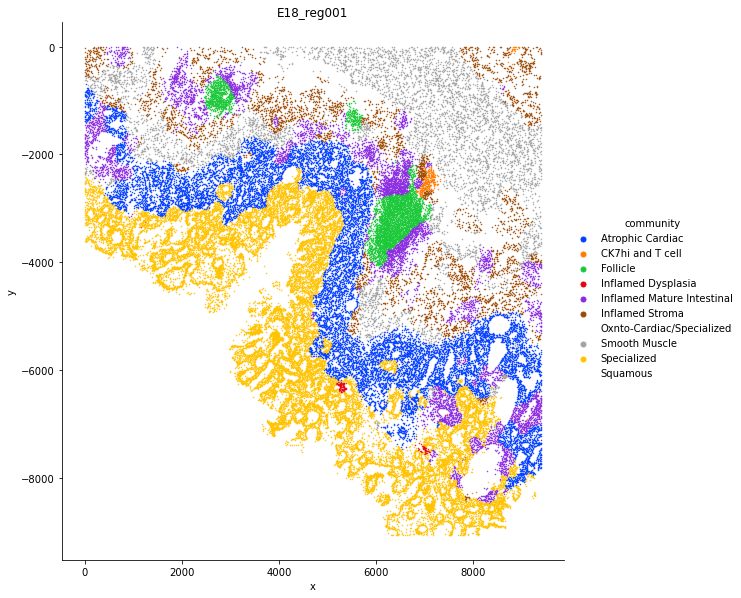

E18_reg002


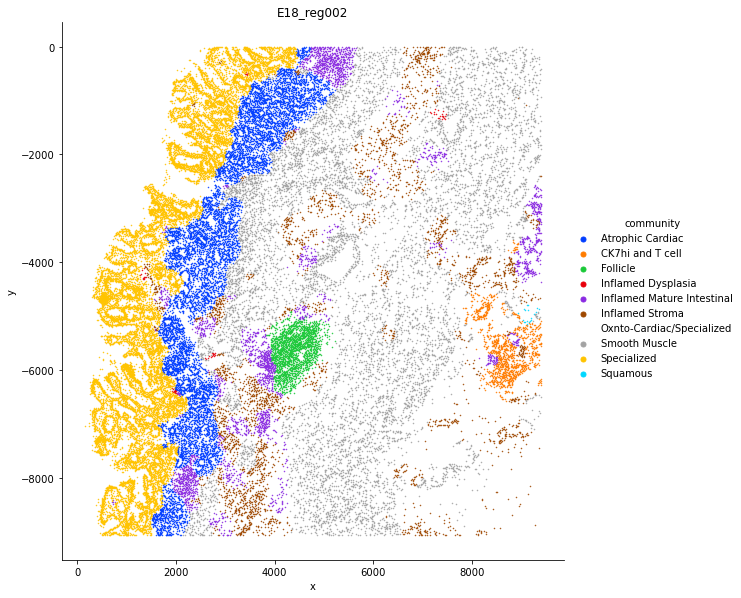

E18_reg003


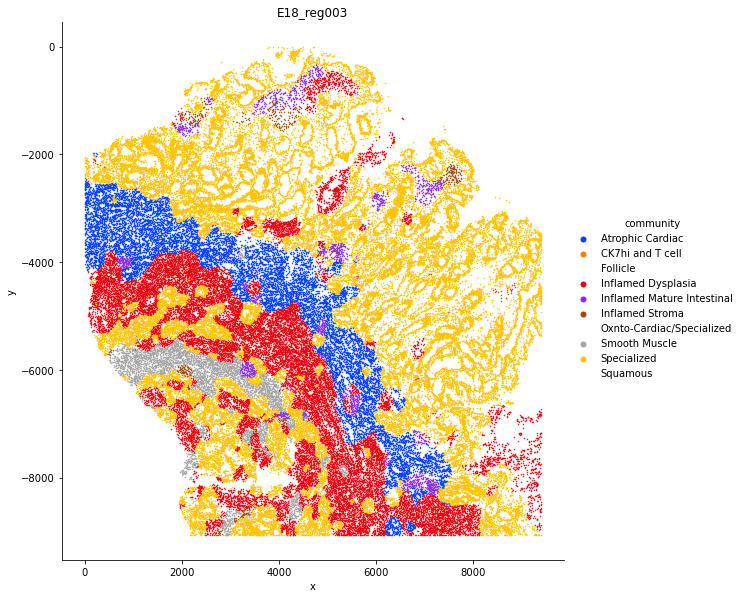

E18_reg004


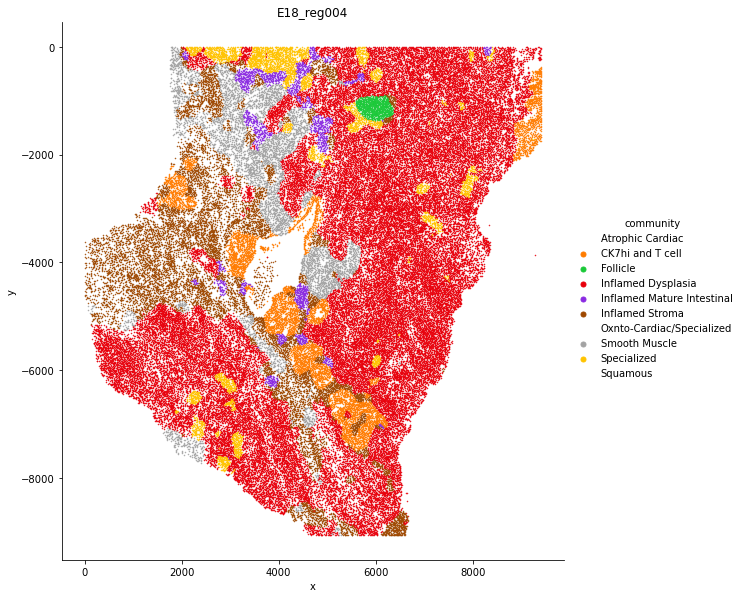

E17_reg001


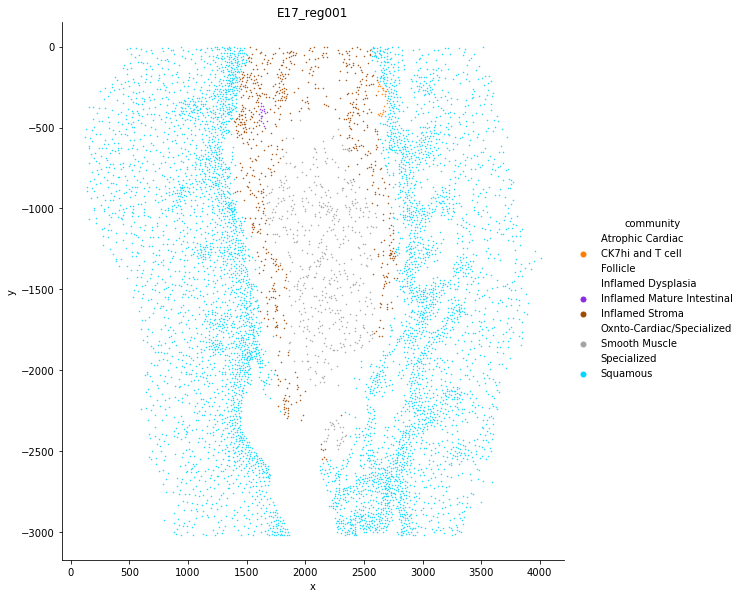

E17_reg002


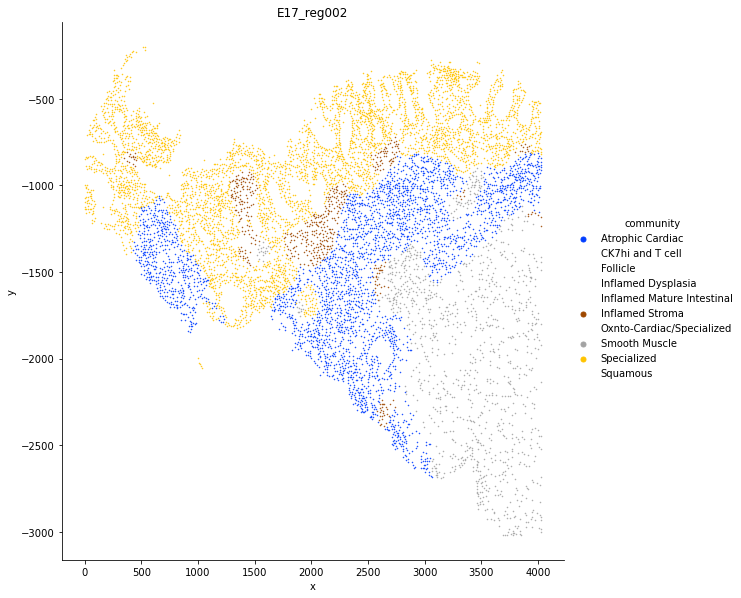

E17_reg003


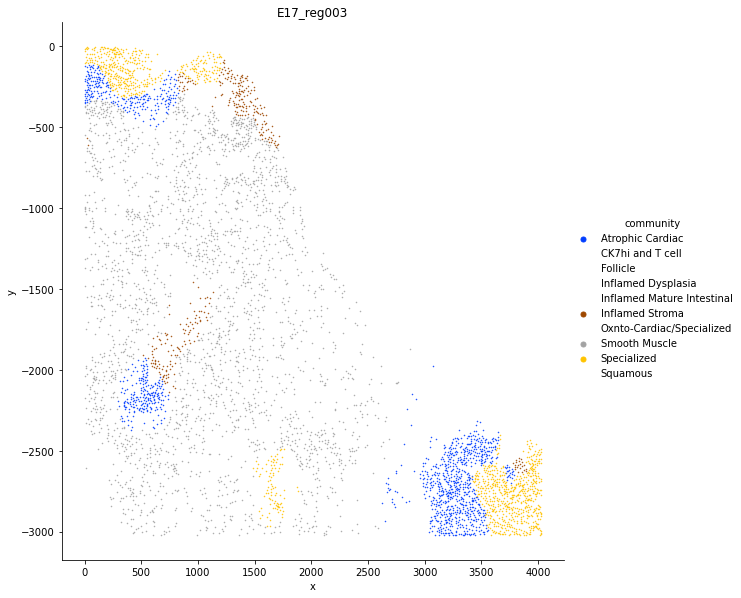

E17_reg004


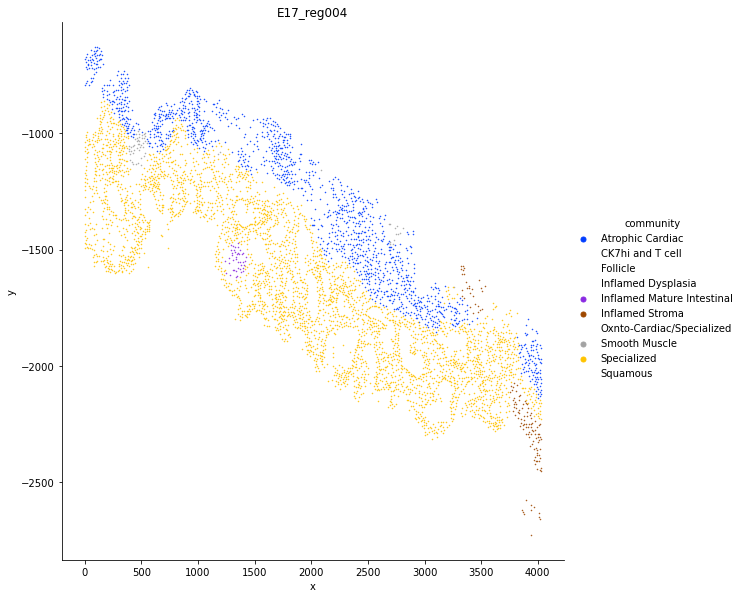

E17_reg005


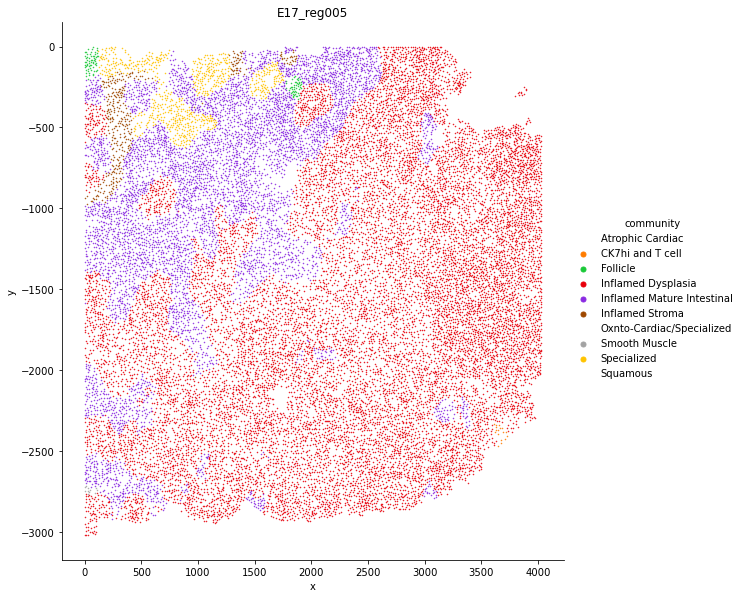

E17_reg006


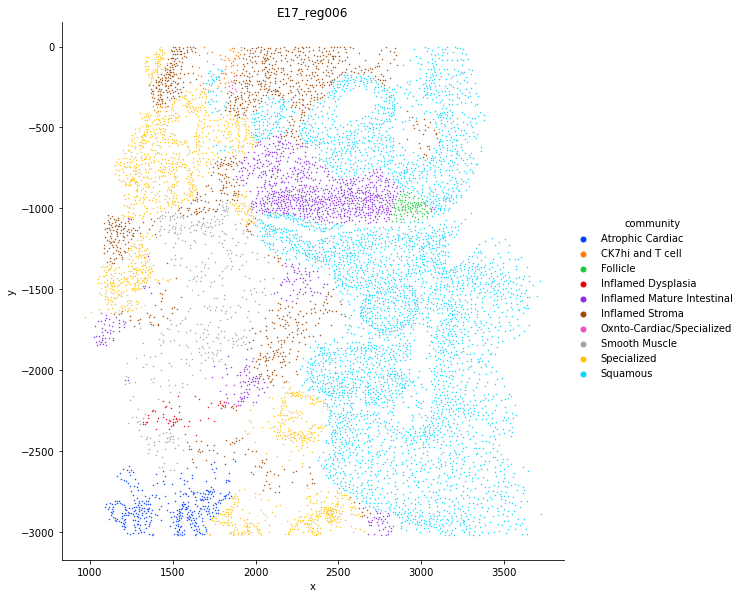

E19_reg001


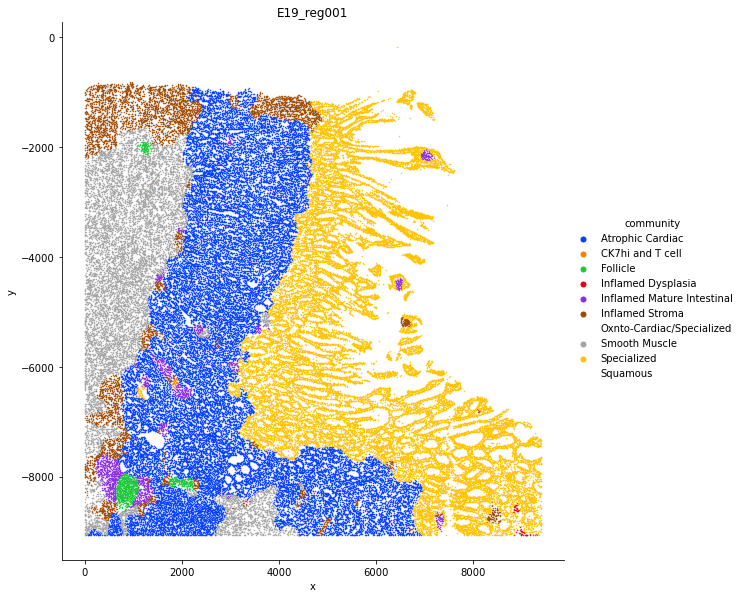

E19_reg002


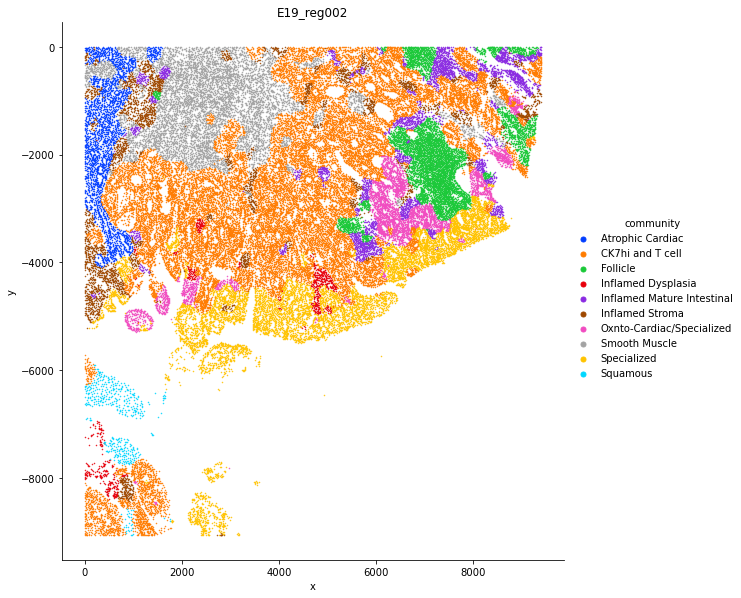

E19_reg003


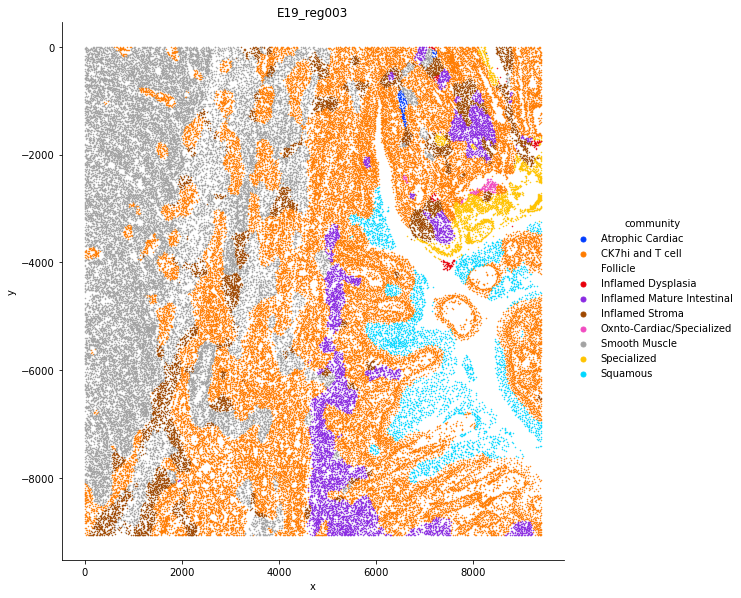

E19_reg004


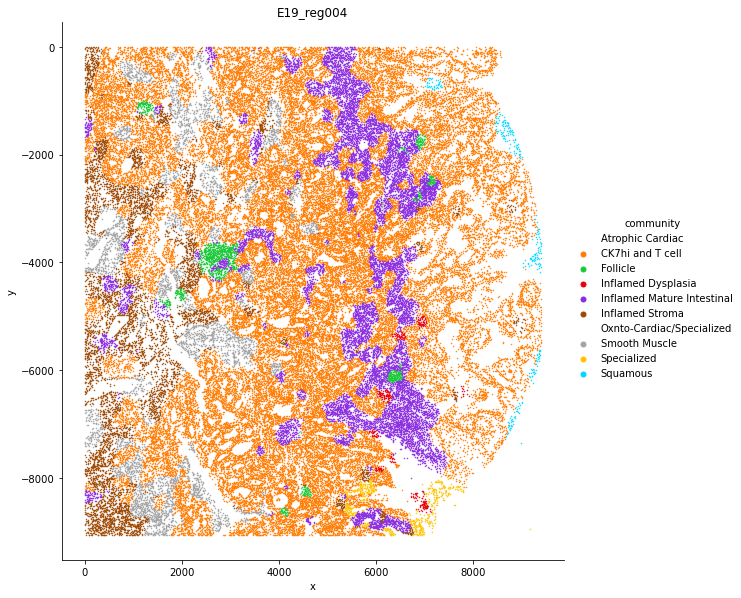

E12_reg001


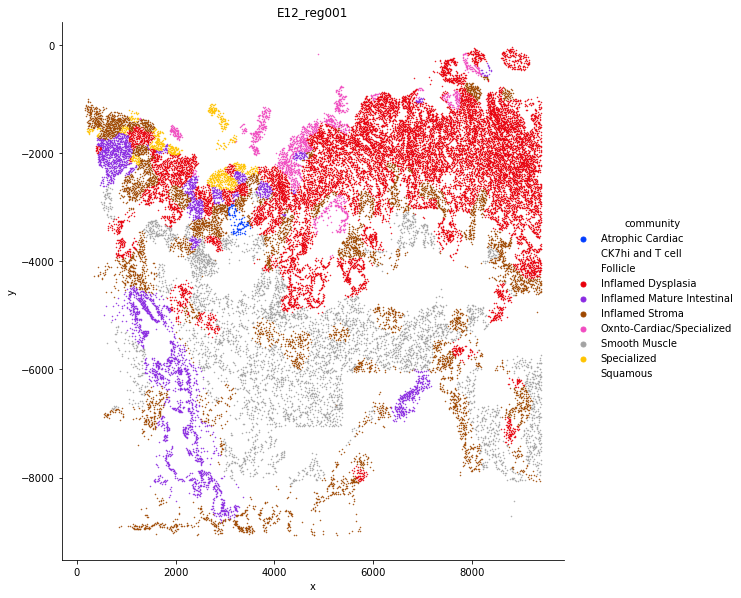

E12_reg002


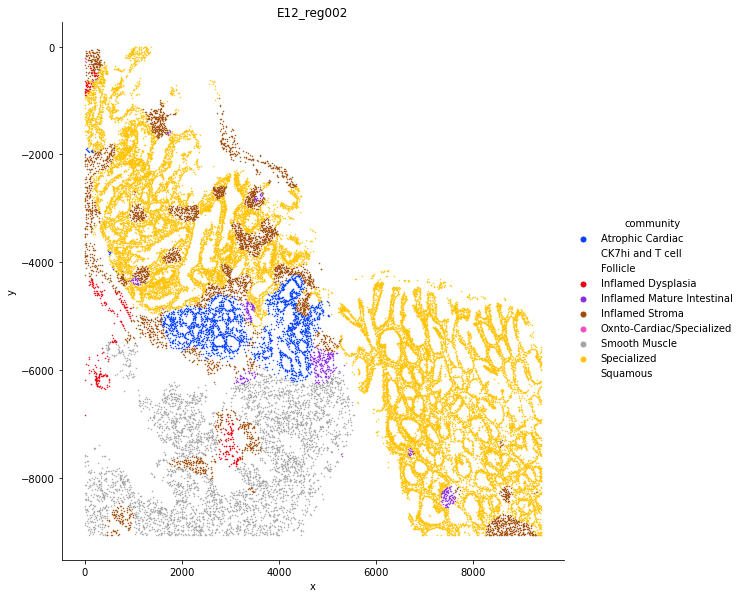

E12_reg003


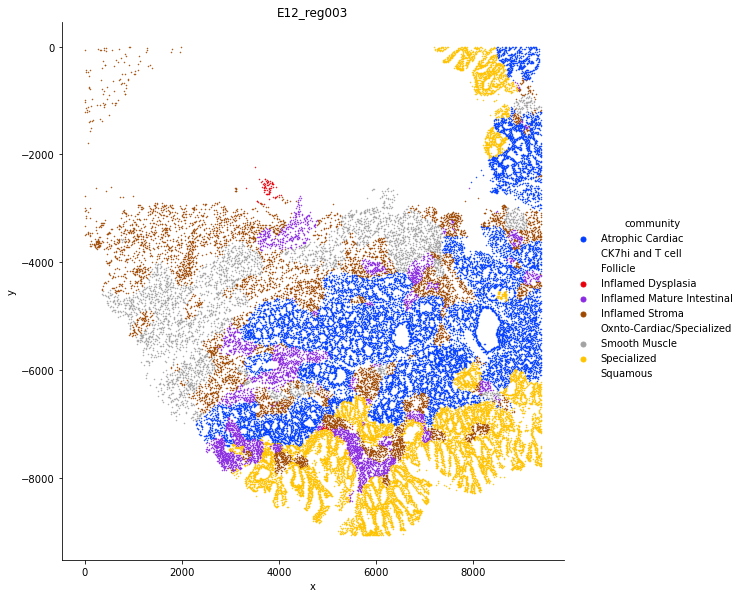

E12_reg004


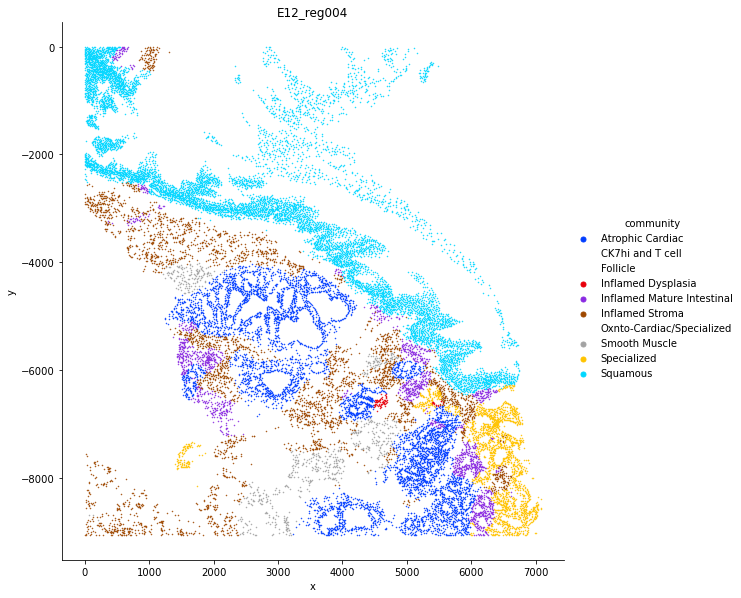

E12_reg005


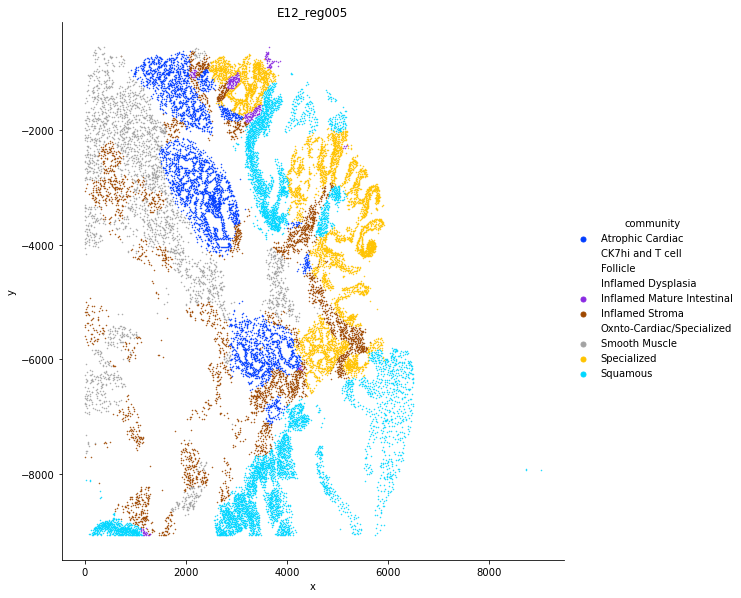

In [14]:
n_conversion_sub = {
'Inflamed Dysplasia':'Inflamed Dysplasia',
 'Inflamed Mature Intestinal':'Inflamed Dysplasia',
 'Smooth Muscle':'Inflamed Stroma',
 'Inflamed Stroma':'Inflamed Stroma',
 'Specialized':'Mixed Epithelial',
 'Oxnto-Cardiac/Specialized':'Mixed Epithelial',
 'Atrophic Cardiac':'Mixed Epithelial',
 'Squamous':'Squamous',
 'Follicle':'Inflamed Stroma',
 'CK7hi and T cell':'Mixed Epithelial'
}
cells['community common']=cells['community'].map(n_conversion_sub)

#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
# figs1 = catplot(cells,X = X,Y=Y,exp = reg,
#                hue = 'community common',invert_y=True,size = 1,figsize=8)
figs2 = catplot(cells,X = X,Y=Y,exp = reg,
               hue = 'community',invert_y=True,size = 1,figsize=8)

In [ ]:
for n,f in enumerate(figs1):
    f.savefig(save_path+str(k)+'comm_common_{}.png'.format(n), dpi=600)
for n,f in enumerate(figs2):
    f.savefig(save_path+str(k)+'comm_{}.png'.format(n), dpi=600)

In [15]:
pal_temp = {
 
    'a':'dodgerblue',
    'b':'lightskyblue',
    'c':'red',
    'd':'orange',
    'e':'mediumpurple',
    'f':'thistle',
    'g':'lightgreen',
    'h':'green',
    'i':'gold',
    'j':'yellow',
    'k':'gray',
    'l':'brown',
    
    'Productive T cell & Tumor': sns.color_palette('bright')[0], 
'Immune Cells': sns.color_palette('bright')[9],
 'Unproductive T Cell Tumor Interface': sns.color_palette('bright')[3],
 'Neutrophils & Tumor': sns.color_palette('bright')[8],
 'Immunosuppressive Endothelial': sns.color_palette('bright')[4],
 'NK cell':'plum',

 'Ki67+ Tumor': sns.color_palette('bright')[2],
 'Tumor': sns.color_palette('bright')[7],
 'Vasculature': sns.color_palette('bright')[6],
 'Immunosuppressive Antigen Presenting Cells': sns.color_palette('bright')[5],

   'Plasma cell':'gold',  
   'CD4+ T cell':'yellowgreen',
   'CK7+ Epithelial cell':'tan',
   'Neck cell':'navy',
  'Neuroendocrine cell':'bisque',   
 'Chief cell':'goldenrod',
  'Goblet cell':'blueviolet',
  'Foveolar cell':'darkorange',   
 'Stromal cell':'teal',
 'PDPN+ Stromal cell':'olive',
 'p63+ EGFR+ Epithelial cell':'dimgray',
 'Gastric mucouse secreting cell':'indigo',
 'Biglycan+ Stromal cell':'lightcoral',
 'Dendritic cell':'cyan',
 'Paneth cell':'ivory',
 'B cell':'beige',
 'Squamous Epithelial cell':'darkblue',
 'Immune unknown cell':'lightcyan',
 'p63+ Epithelial cell':'royalblue',

  'Nerve cell':'magenta',
     'CD8+ T cell':'black',
  'Neutrophil':'skyblue',
 'Parietal cell':'fuchsia',
    
}

In [16]:
cell_dict_con = {
    'B': 'B cell',
 'CD4T': 'CD4+ T cell',
 'CD4T_PD1hi': 'CD4+ T cell PD1+',
 'CD4Treg': 'CD4+ Treg',
 'CD8T': 'CD8+ T cell',
 'CD8T_PD1hi': 'CD8+ T cell PD1+',
 'DC': 'DC',
 'Endothelial': 'Endothelial',
 'Endothelial_CD36hi': 'Endothelial CD36hi',
 'Endothelial_aSMAhi': 'Endothelial aSMAhi',
 'Epi': 'Epithelial',
 'Epi_AnnexinA1': 'Squamous Annexin A1+',
 'Epi_CD73': 'Epithelial CD73hi',
 'Epi_CHGA': 'Neuroendocrine',
 'Epi_CK7': 'Epithelial CK7+',
 'Epi_CK7_p53': 'Epithelial CK7+ p53+',
 'Epi_HLADR': 'Epithelial HLADR+',
 'Epi_Ki67_p53': 'Epithelial Ki67+ p53+',
 'Epi_MUC1_Ki67': 'Epithelial MUC1+ Ki67+',
 'Epi_MUC2': 'Goblet',
 'Epi_MUC2_p53': 'Goblet p53+',
 'Epi_MUC2_p53_Ki67': 'Goblet Ki67+ p53+',
 'Epi_MUC5AC': 'Foveloar',
 'Epi_MUC5AC_Ki67_p53': 'Foveloar Ki67+ p53+',
 'Epi_MUC5_p53': 'Foveloar p53+',
 'Epi_MUC5_p53_Ki67': 'Foveloar Ki67+ p53+',
 'Epi_MUC6': 'Neck',
 'Epi_MUC6_p53': 'Neck p53+',
 'Epi_MUC6_p53_Ki67': 'Neck Ki67+ p53+',
 'Epi_PGA3': 'Chief',
 'Epi_PP': 'Parietal',
 'Epi_aDef5': 'Paneth',
 'Epi_p53': 'Epithelial p53+',
 'Epi_p63_EGFR': 'Squamous p63+',
 'Epi_p63_EGFRhi': 'Squamou p63+ EGFRhi',
 'Epi_pH2AX': 'Epithelial pH2AX+',
 'Lymphatic': 'Lymphatic',
 'Lymphatic_CD73hi': 'Lymphatic CD73+',
 'M1_Macrophage': 'M1 Macrophage',
 'M2_Macrophage': 'M2 Macrophage',
 'Nerve': 'Nerve',
 'Neutrophil': 'Neutrophil',
 'Plasma': 'Plasma',
 'Smooth_Muscle': 'Smooth Muscle',
 'Stroma': 'Stroma',
 'Stroma_CD73': 'Stroma CD73+'
}

cells['Cell Type']=cells['final_cell_types'].map(cell_dict_con)

In [19]:
grouped = cells.groupby(['community']).count()['neigh_name']
g22 = grouped.sort_values( ascending=False)
cond_list = list(g22.index)
color_list=list(pal_temp.values())
color_dict = dict(zip(cond_list, color_list))

In [ ]:
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
figs = catplot(cells,X = X,Y=Y,exp = reg,
               hue = 'Cell Type',invert_y=True,size = 1,figsize=8, palette=color_dict)

E08_reg001


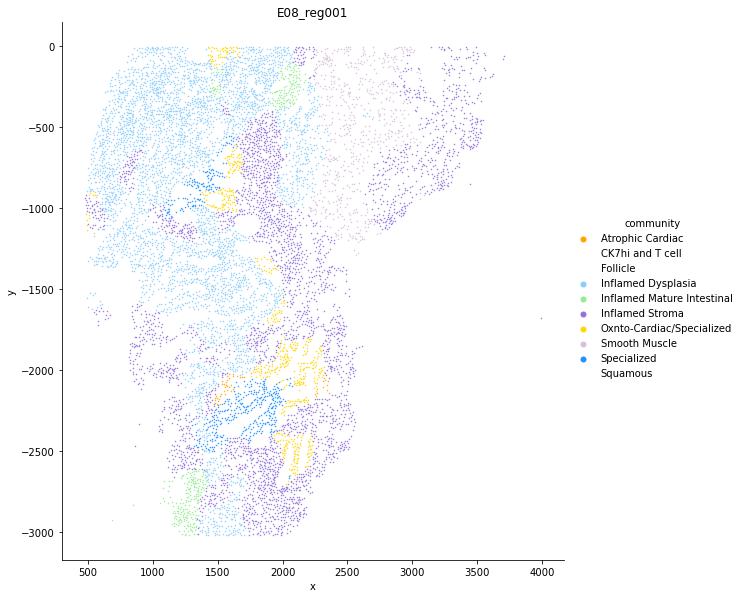

E08_reg002


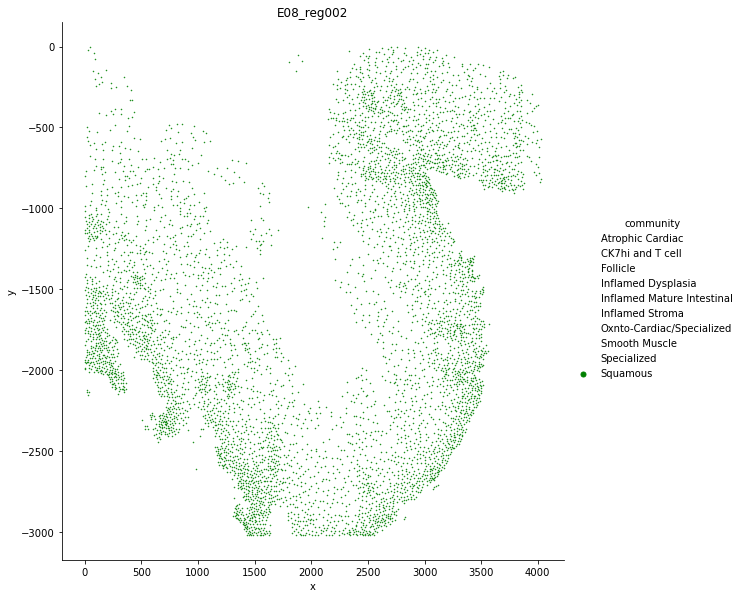

E08_reg003


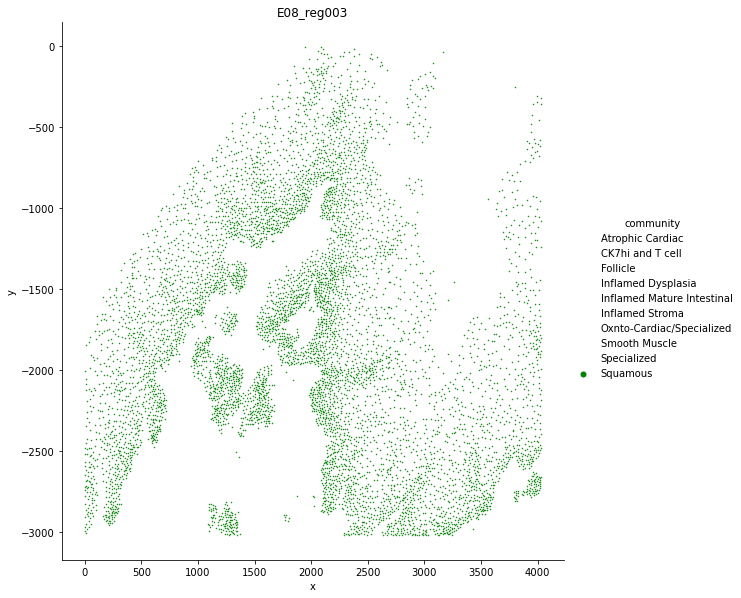

E08_reg004


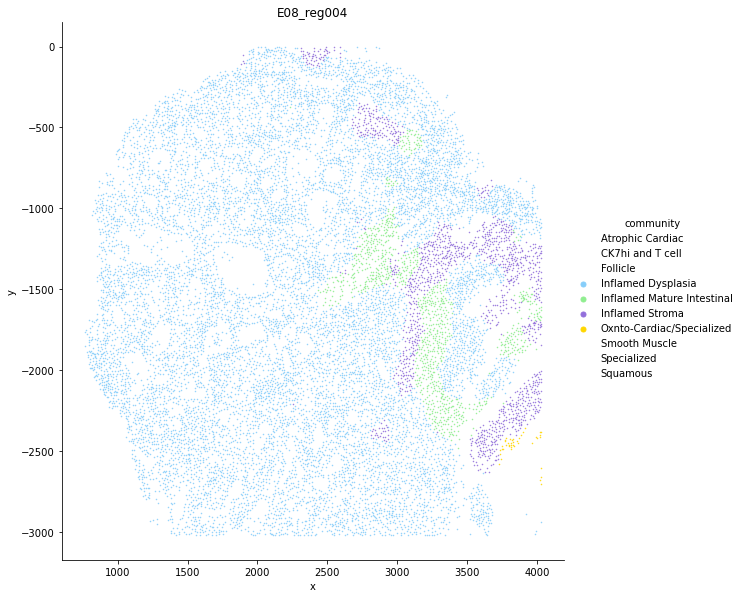

E08_reg005


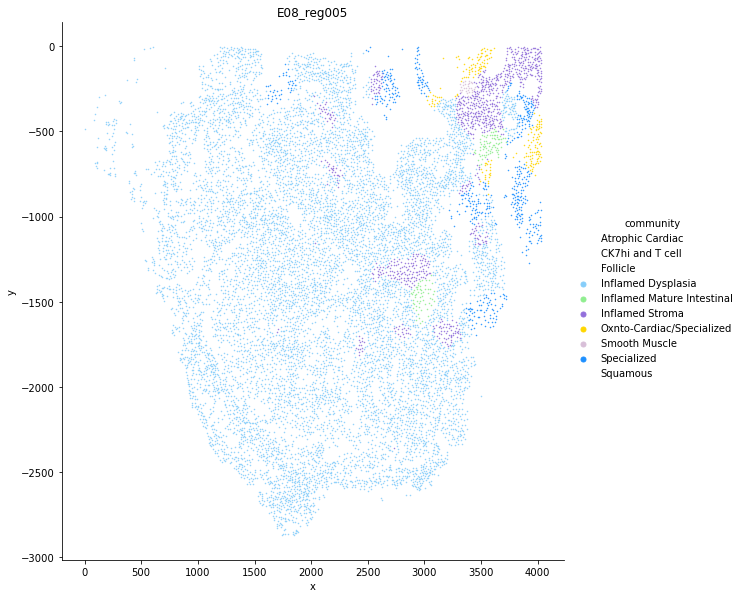

E08_reg006


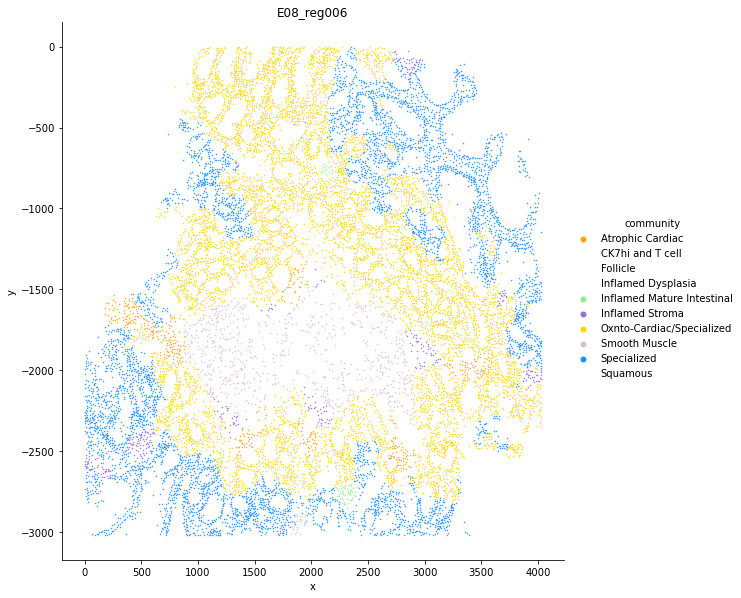

E08_reg007


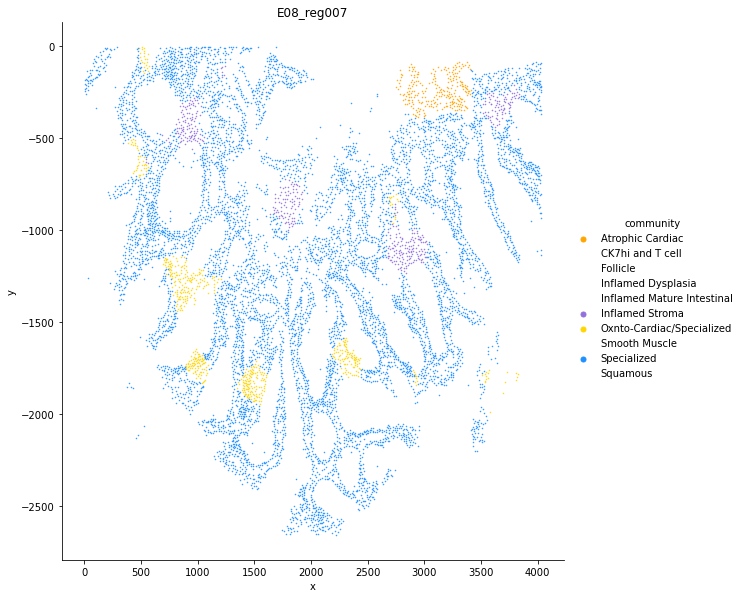

E11_reg001


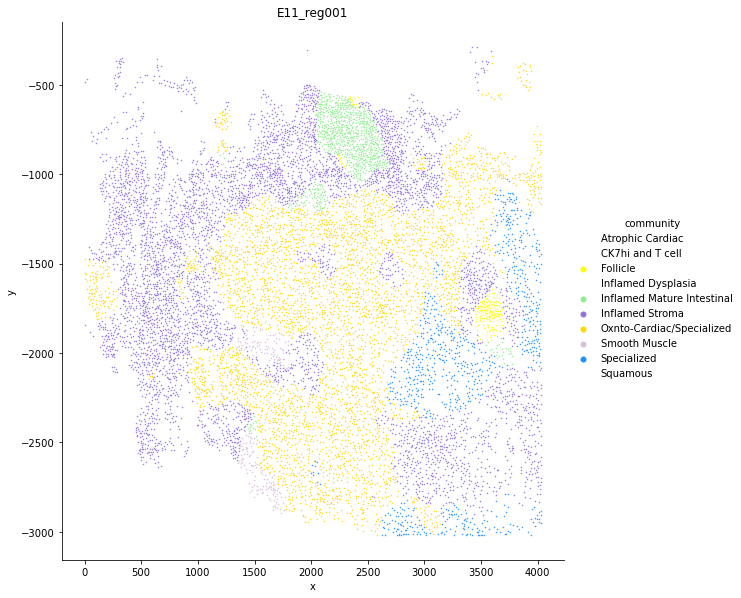

E11_reg002


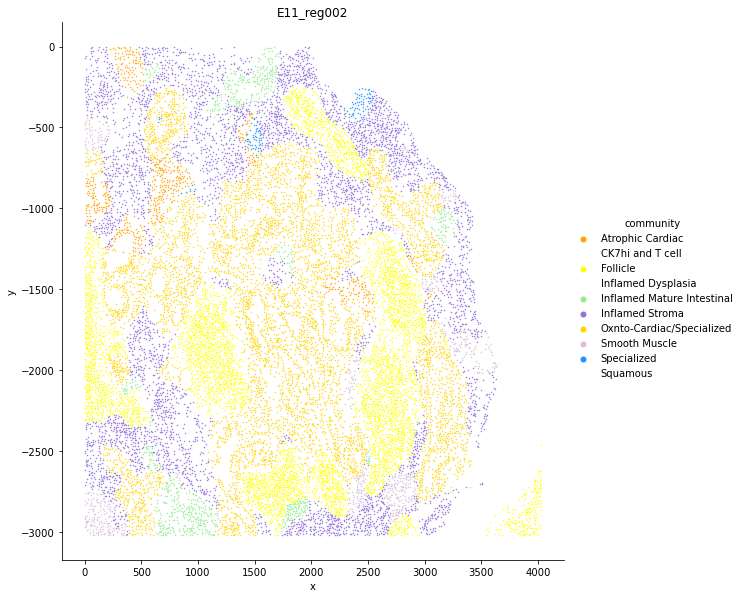

E11_reg003


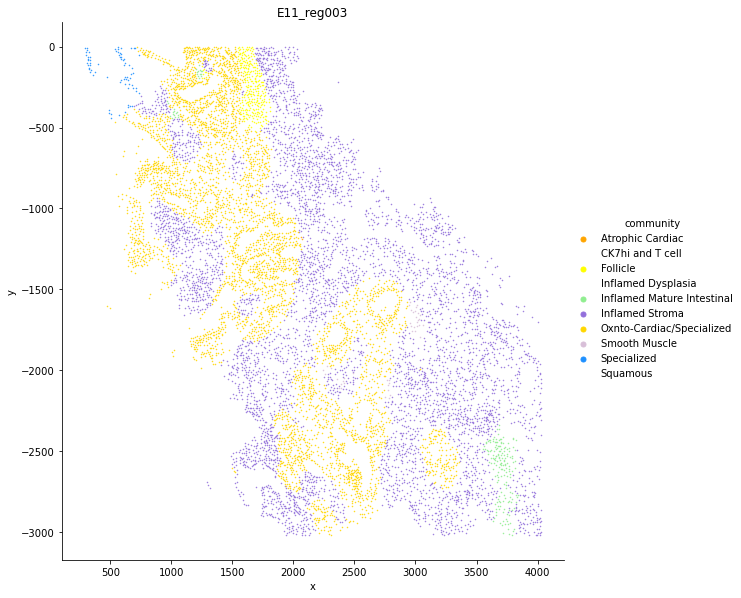

E11_reg004


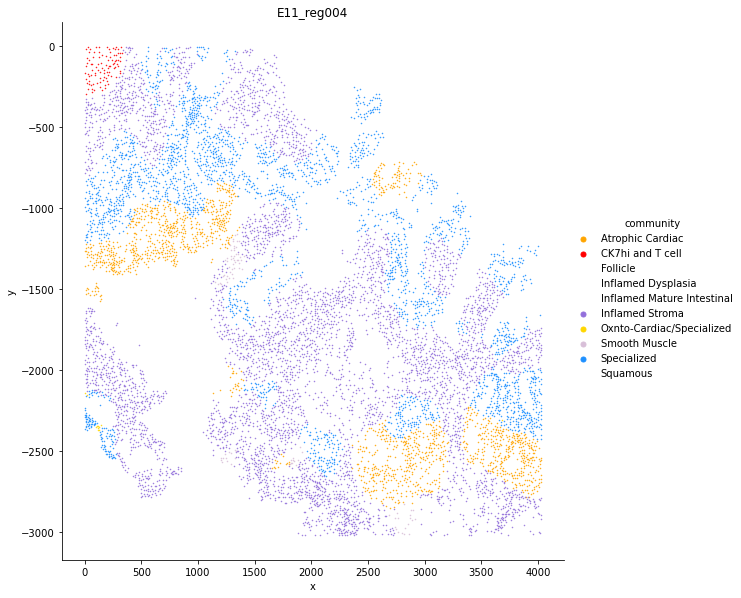

E11_reg005


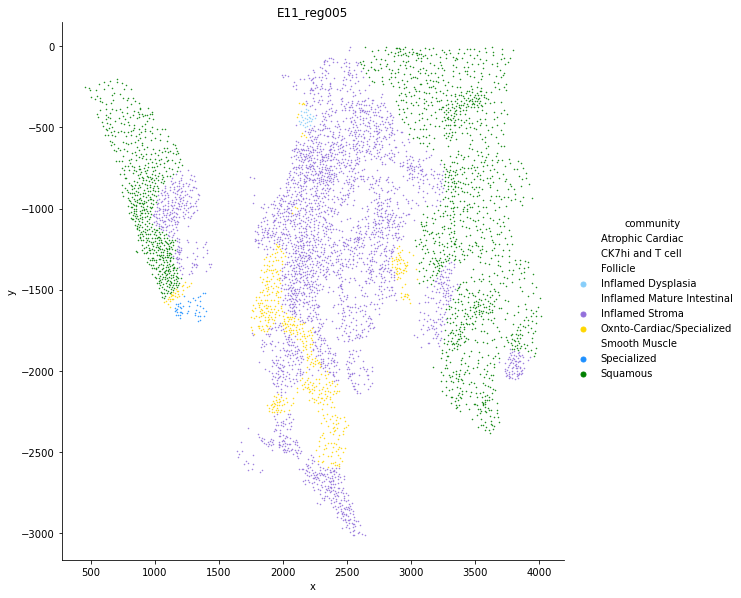

E11_reg006


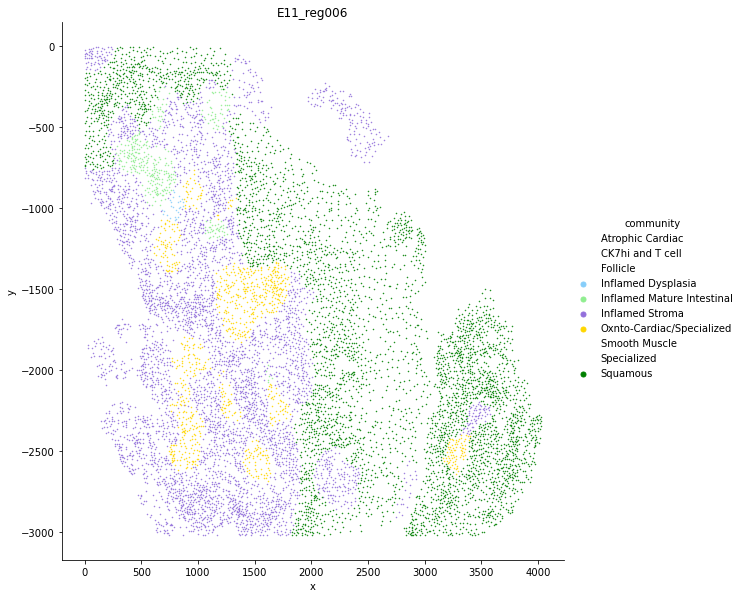

E18_reg001


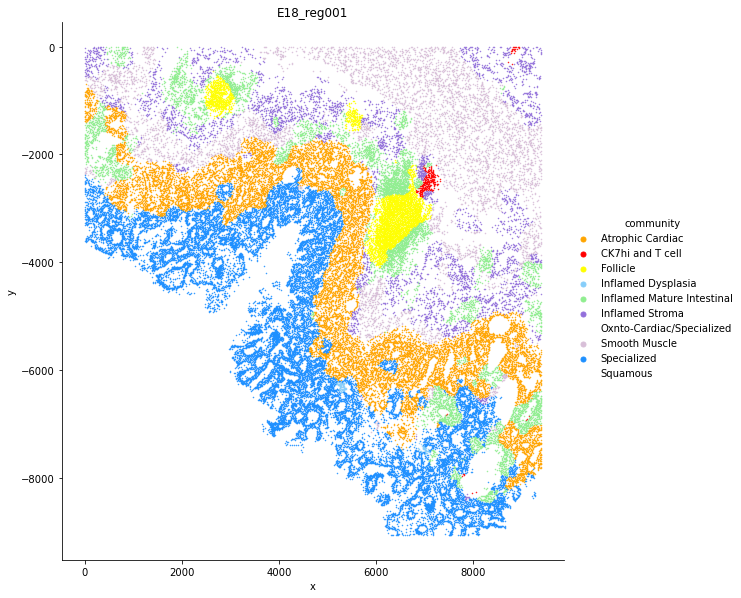

E18_reg002


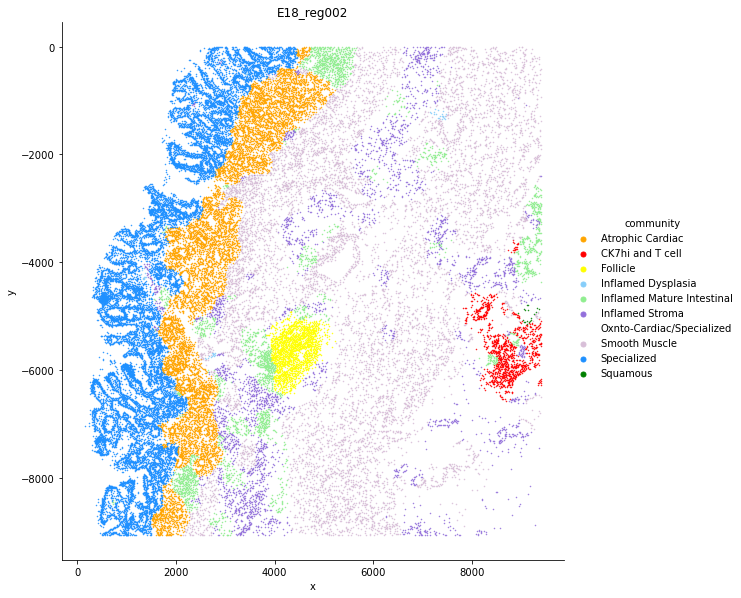

E18_reg003


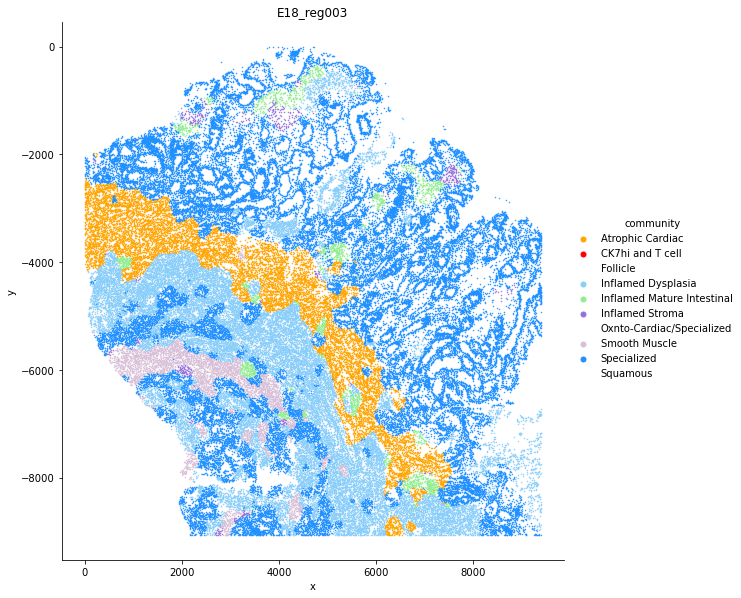

E18_reg004


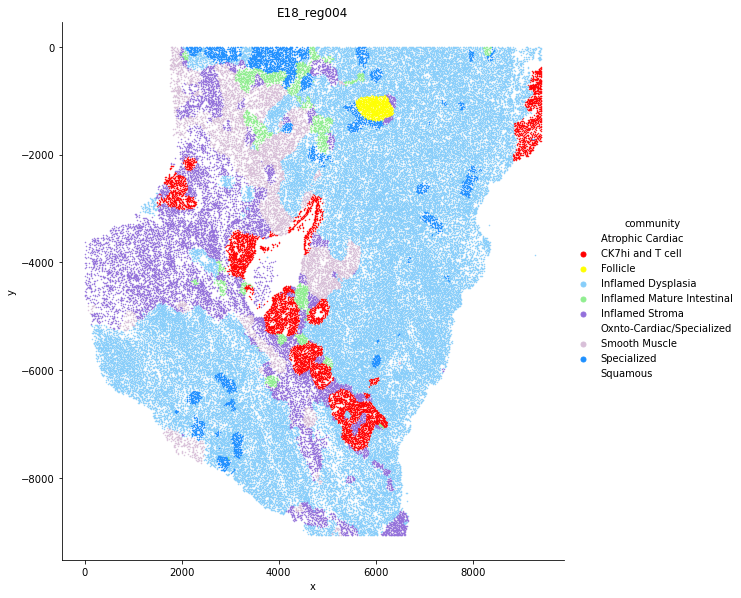

E17_reg001


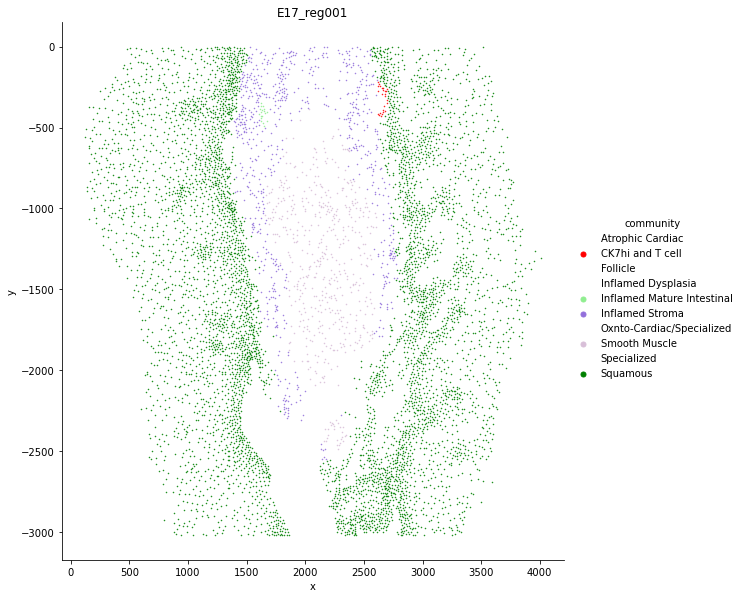

E17_reg002


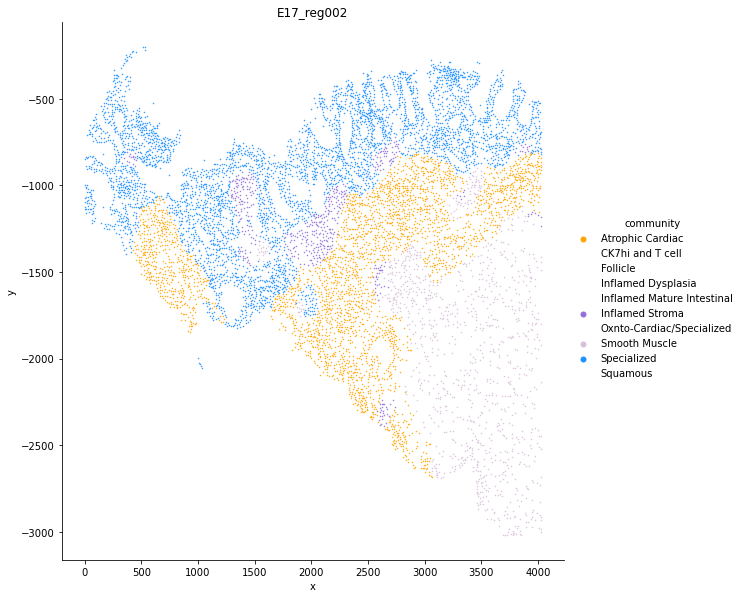

E17_reg003


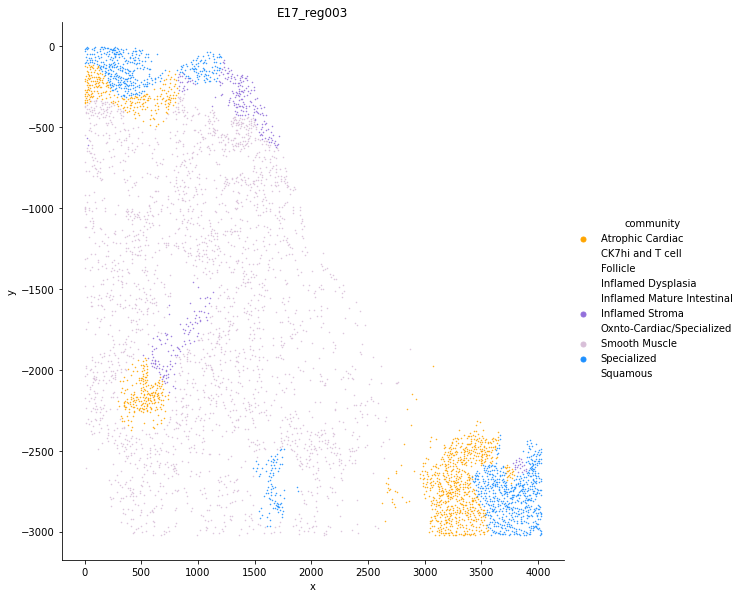

E17_reg004


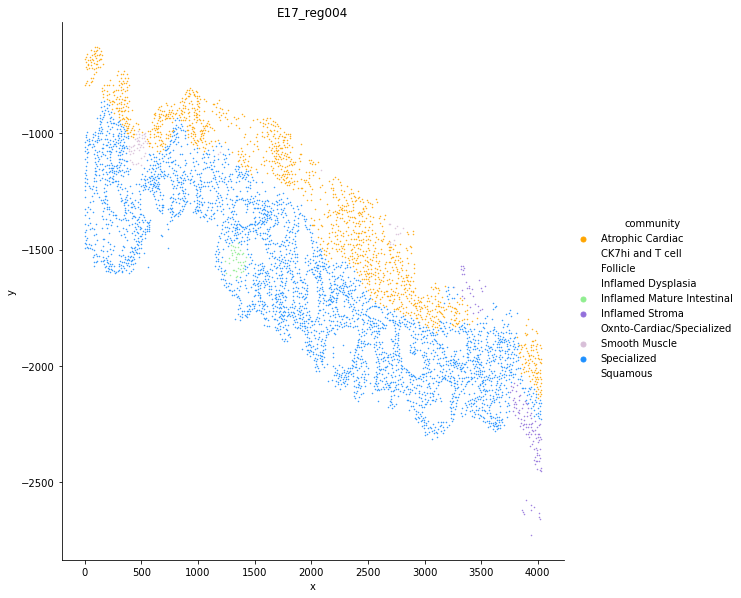

E17_reg005


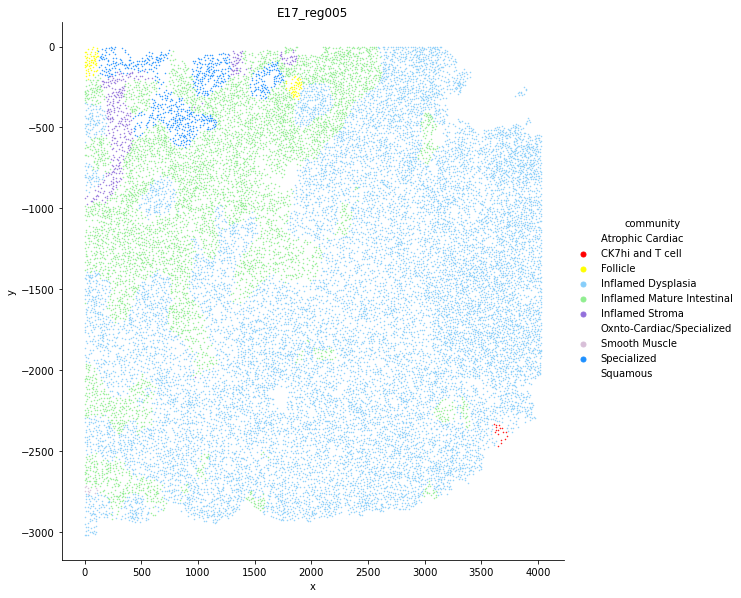

E17_reg006


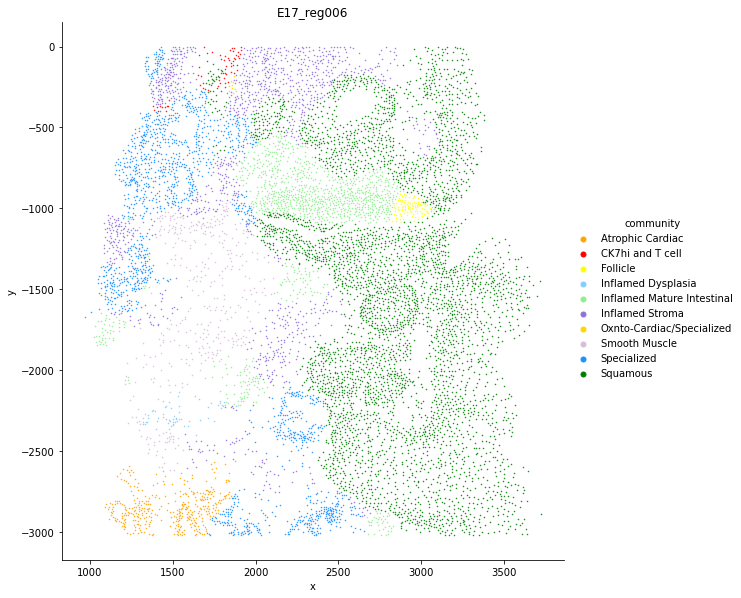

E19_reg001


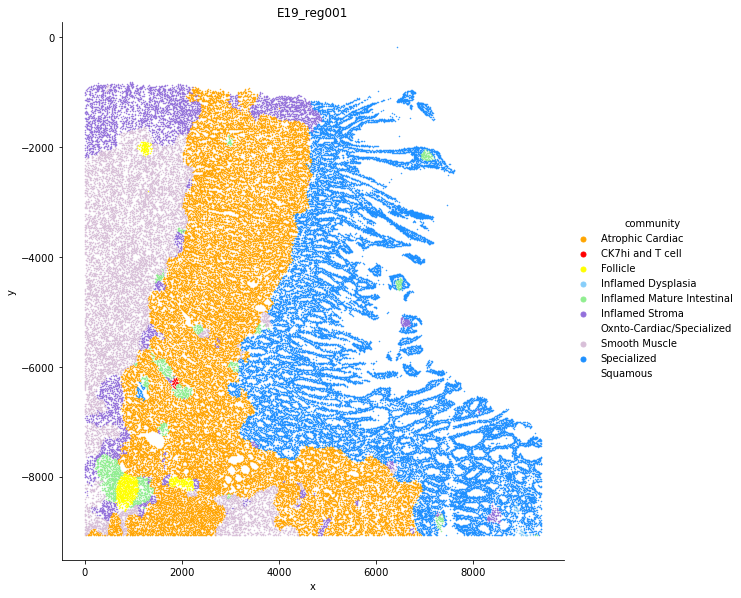

E19_reg002


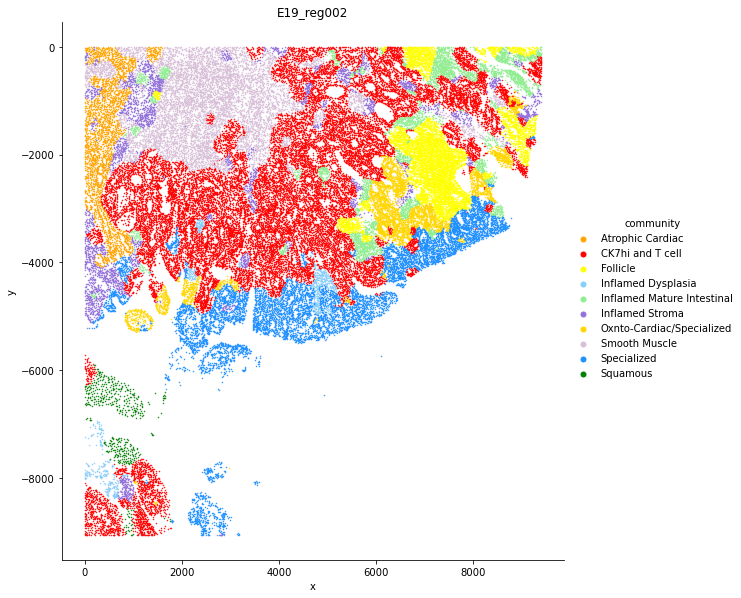

E19_reg003


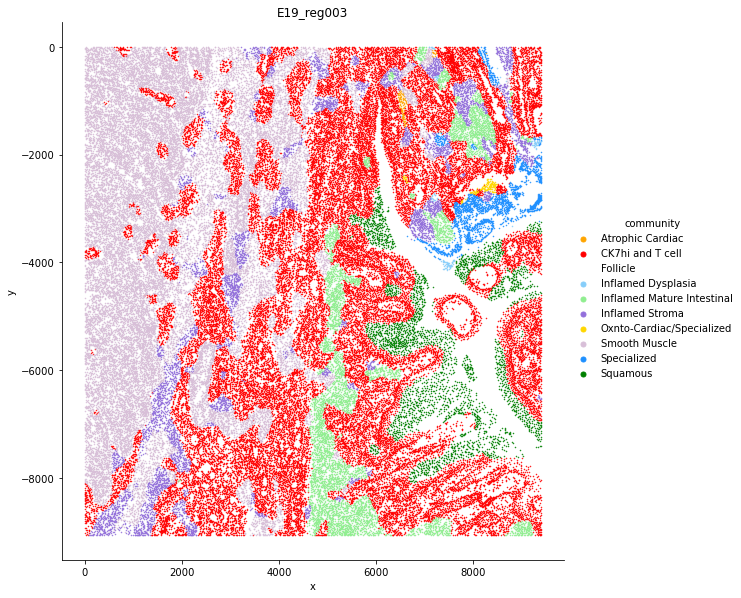

E19_reg004


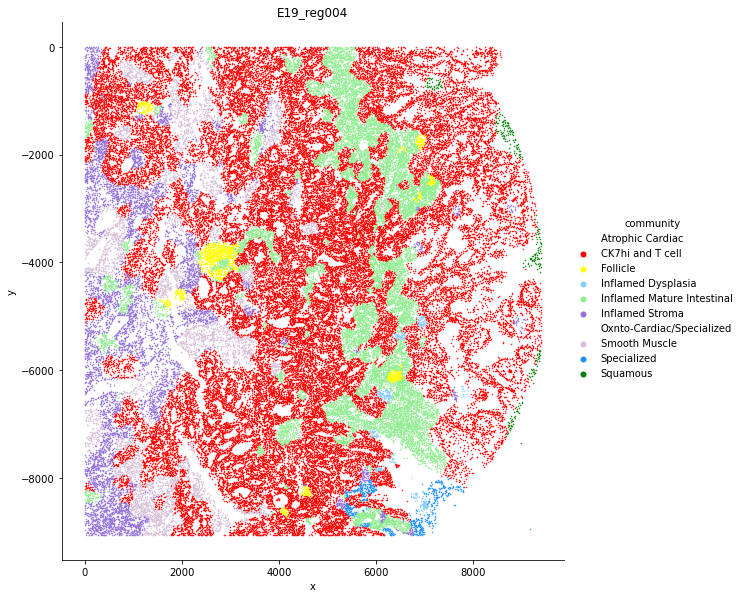

E12_reg001


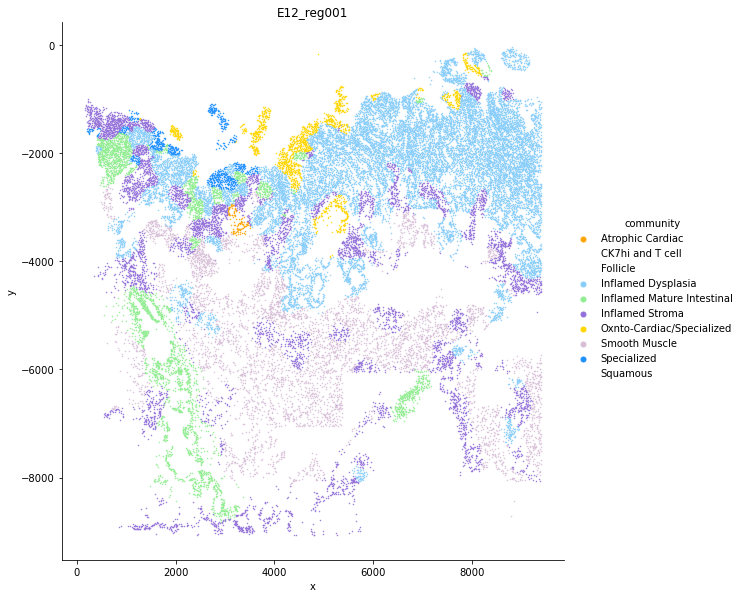

E12_reg002


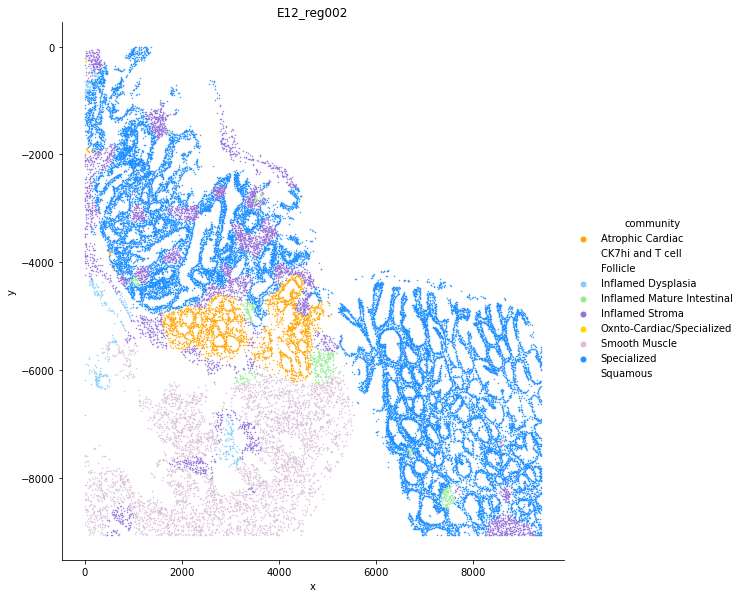

E12_reg003


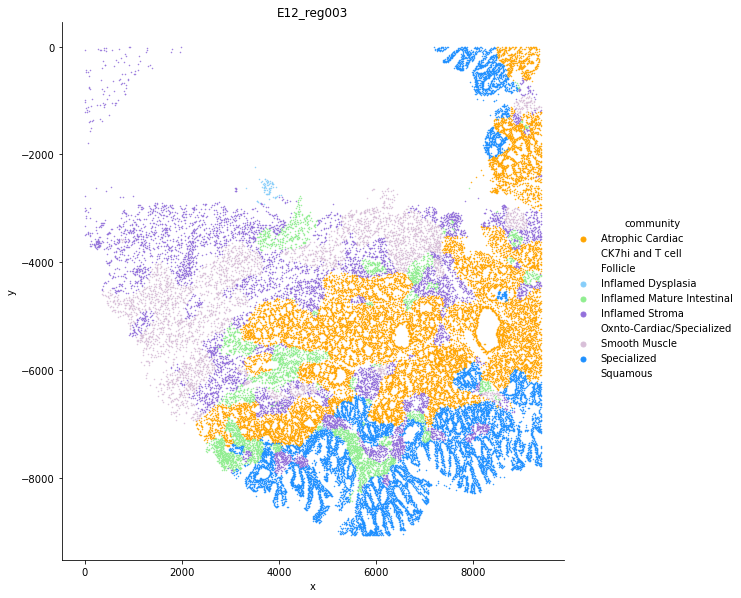

E12_reg004


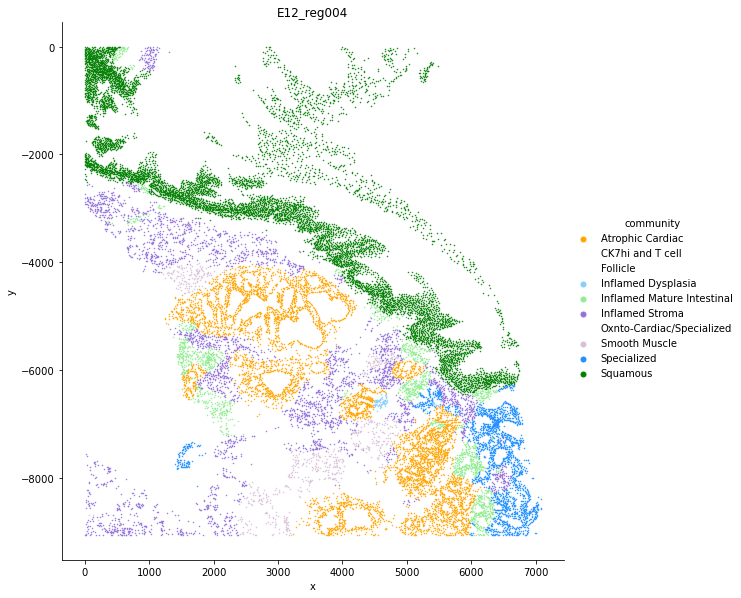

E12_reg005


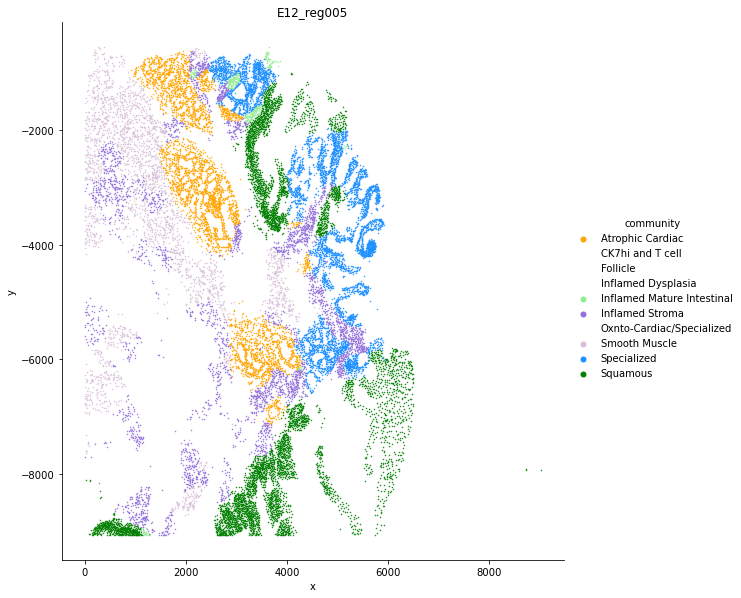

In [20]:
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
figs = catplot(cells,X = X,Y=Y,exp = reg,
               hue = 'community',invert_y=True,size = 1,figsize=8, palette=color_dict)

In [ ]:
for n,f in enumerate(figs):
    f.savefig(save_path+str(k)+'BE_cell{}.png'.format(n), dpi=600)

In [ ]:
#modify figure size aesthetics for each neighborhood
figs_c = catplot(cells.loc[cells.final_cell_types.isin(['Epi_AnnexinA1','Epi_p63_EGFR','Epi_p63_EGFRhi'])],X = X,Y=Y,exp = reg,
               hue = 'final_cell_types',invert_y=True,size = 1,figsize=8)#,palette=pal_color_cells)

In [ ]:
sum_cols

In [ ]:
cells_out = cells.drop(columns=sum_cols)
cells_out.columns.to_list()

In [ ]:
cells_out.to_csv(save_path+'21_11_17_CellAtlas_Neighborhoods.csv')

In [ ]:
for n,f in enumerate(figs_c):
    f.savefig(save_path+str(k)+'BE{}.png'.format(n), dpi=600)

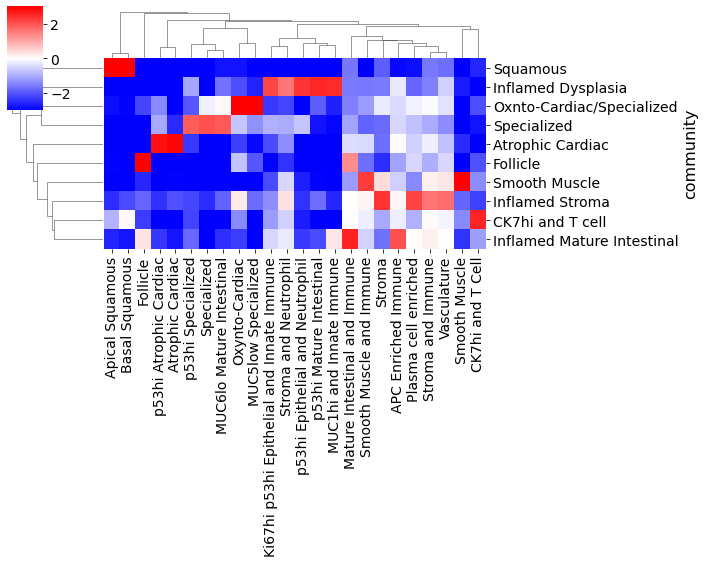

In [21]:
#this plot shows the types of cells (ClusterIDs) in the different niches (0-9)
#font size of graph
SMALL_SIZE = 14
MEDIUM_SIZE = 16
BIGGER_SIZE = 18

#Settings for graph
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

#Find cell frequency within the neighborhoods
cell_list = list(sum_cols)
cell_list.append('community')
cells[sum_cols]
subset = cells[cell_list]
niche_sub = subset.groupby('community').sum()
niche_df = niche_sub.apply(lambda x: x/x.sum() * 10, axis=1)
neigh_clusters = niche_df.to_numpy()

tissue_avgs = values.mean(axis = 0)
fc_2 = np.log2(((neigh_clusters+tissue_avgs)/(neigh_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc_2 = pd.DataFrame(fc_2,columns = sum_cols)
fc_2.set_index(niche_df.index, inplace=True)
s=sns.clustermap(fc_2, vmin =-3,vmax = 3,cmap = 'bwr', figsize=(10,8))
# s.savefig(save_path+"celltypes_perniche_merged_neighborhood_30.png", dpi=600)
# print(save_path)

In [22]:
list(cells.community.unique())

['Inflamed Dysplasia',
 'Inflamed Mature Intestinal',
 'Smooth Muscle',
 'Inflamed Stroma',
 'Specialized',
 'Oxnto-Cardiac/Specialized',
 'Atrophic Cardiac',
 'Squamous',
 'Follicle',
 'CK7hi and T cell']

In [29]:
comm_dict = {
 'Inflamed Dysplasia':sns.color_palette('bright')[2],
 'Inflamed Mature Intestinal':sns.color_palette('bright')[6],
 'Smooth Muscle':sns.color_palette('bright')[3],
 'Inflamed Stroma': sns.color_palette('bright')[9],
 'Specialized':sns.color_palette('bright')[4],
 'Oxnto-Cardiac/Specialized': sns.color_palette('bright')[1],
 'Squamous': sns.color_palette('bright')[7],
 'Follicle': sns.color_palette('bright')[8],
 'CK7hi and T cell': sns.color_palette('bright')[5],
 'Atrophic Cardiac': sns.color_palette('bright')[0]
}

neigh_data = pd.DataFrame({
    'community':list(comm_dict.keys()),
    'color':list(comm_dict.values())
})
neigh_data.set_index(keys='community',inplace=True)
neigh_data

,color
community,
Inflamed Dysplasia,"(0.10196078431372549, 0.788235294117647, 0.219..."
Inflamed Mature Intestinal,"(0.9450980392156862, 0.2980392156862745, 0.756..."
Smooth Muscle,"(0.9098039215686274, 0.0, 0.043137254901960784)"
Inflamed Stroma,"(0.0, 0.8431372549019608, 1.0)"
Specialized,"(0.5450980392156862, 0.16862745098039217, 0.88..."
Oxnto-Cardiac/Specialized,"(1.0, 0.48627450980392156, 0.0)"
Squamous,"(0.6392156862745098, 0.6392156862745098, 0.639..."
Follicle,"(1.0, 0.7686274509803922, 0.0)"
CK7hi and T cell,"(0.6235294117647059, 0.2823529411764706, 0.0)"


/Users/jwhickey/Nolan Lab Dropbox/John Hickey/CRUK/Cell_Atlas/analysis/


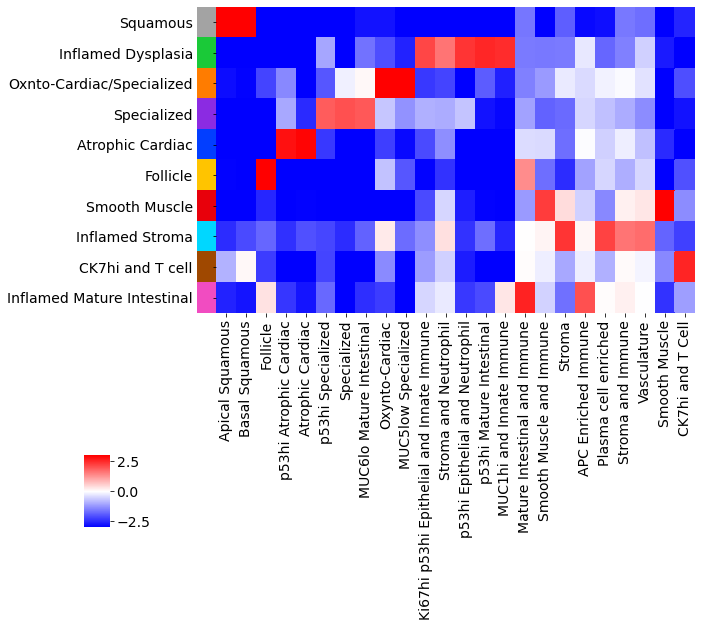

In [30]:
#Find cell frequency within the neighborhoods
cell_list = list(sum_cols)
cell_list.append('community')
subset = cells[cell_list]
niche_sub = subset.groupby('community').sum()
niche_df = niche_sub.apply(lambda x: x/x.sum() * 10, axis=1)
neigh_clusters = niche_df.to_numpy()

tissue_avgs = values.mean(axis = 0)
fc_2 = np.log2(((neigh_clusters+tissue_avgs)/(neigh_clusters+tissue_avgs).sum(axis = 1, keepdims = True))/tissue_avgs)
fc_2 = pd.DataFrame(fc_2,columns = sum_cols)
fc_2.set_index(niche_df.index, inplace=True)
s=sns.clustermap(fc_2, vmin =-3,vmax = 3,cmap = 'bwr', figsize=(12,10), row_colors=[neigh_data.reindex(fc_2.index)['color']],\
                cbar_pos=(0.03,0.15,0.03,0.1))

s.ax_row_dendrogram.set_visible(False)
s.ax_col_dendrogram.set_visible(False)
s.ax_heatmap.set_ylabel("", labelpad=25)
s.ax_heatmap.tick_params(axis='y', pad=20)
s.ax_heatmap.yaxis.set_ticks_position("left")

s.savefig(save_path+"community_30_merged.png", dpi=600)
print(save_path)

In [36]:
cells['sample'].unique()

array(['E08', 'E11', 'E18', 'E17', 'E19', 'E12'], dtype=object)

E08_reg001


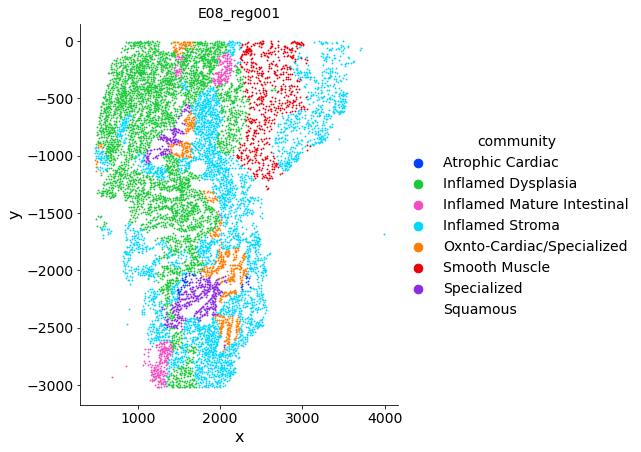

E08_reg002


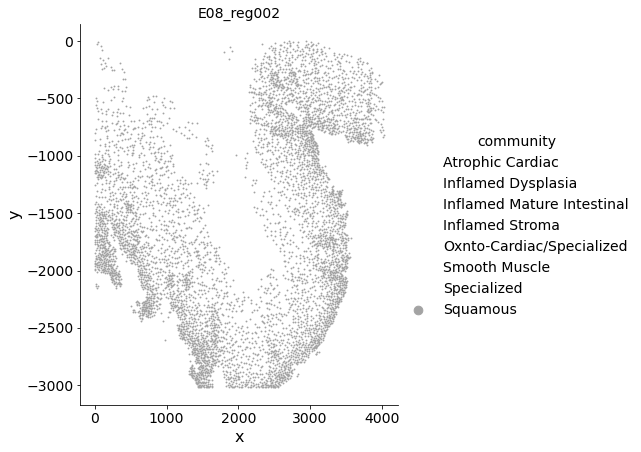

E08_reg003


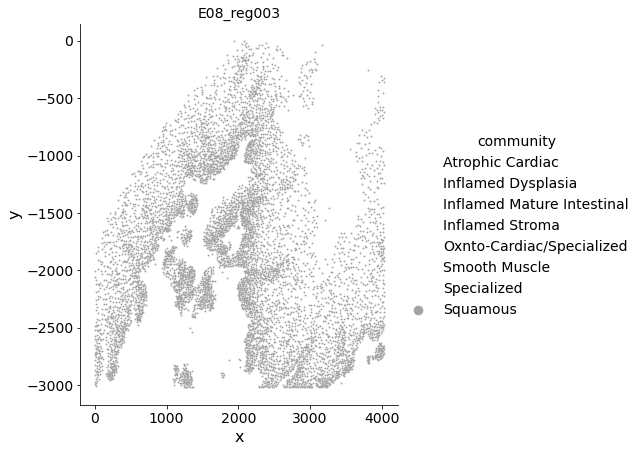

E08_reg004


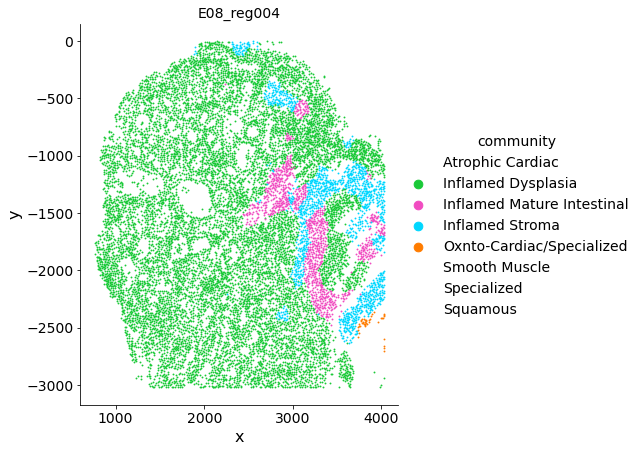

E08_reg005


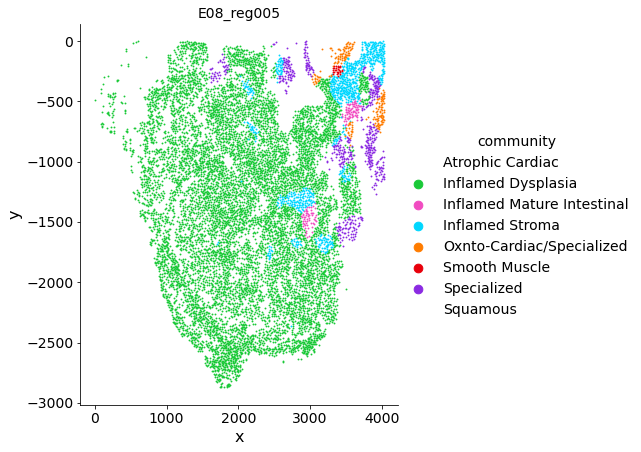

E08_reg006


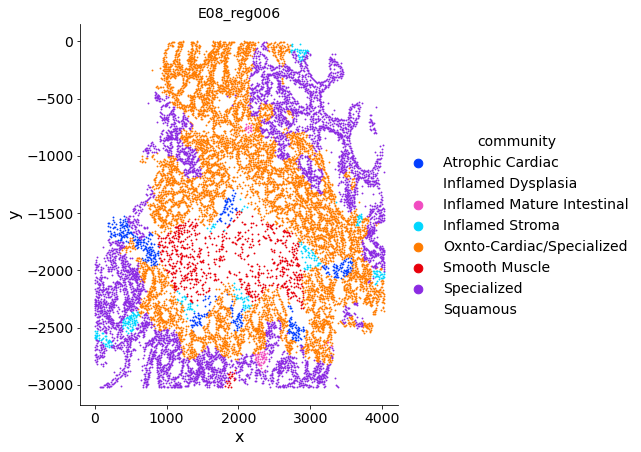

E08_reg007


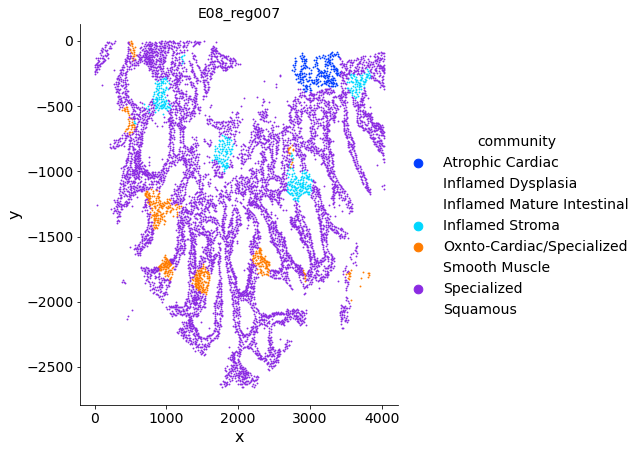

In [37]:
#modify figure size aesthetics for each neighborhood
plt.rcParams["legend.markerscale"] = 10
figs = catplot(cells.loc[cells['sample']=='E08'],X = X,Y=Y,exp = reg,
               hue = 'community',invert_y=True,size = 3,figsize=6, palette=comm_dict)

In [39]:
for n,f in enumerate(figs):
    f.savefig(save_path+str(k)+'BE_comm{}.png'.format(n), dpi=600, transparent=True)

In [40]:
cells.columns

Index(['Unnamed: 0.1', 'CHGA', 'MMP9', 'CD36', 'CK7', 'PDL1', 'Bcatenin',
       'Vimentin', 'FoxP3', 'CD56', 'CD31', 'pH2AX', 'CD90', 'CD15', 'PD1',
       'aSMA', 'CD25', 'Ki67', 'Cytokeratin', 'CD20', 'CD4', 'CD11c',
       'AnnexA1', 'Nestin', 'p53', 'CD73', 'EGFR', 'MUC5AC', 'HLADR', 'COX2',
       'BCL2', 'p63', 'CD3', 'MUC2', 'CD8', 'CD45', 'PGA3', 'CD57', 'CD68',
       'aDef5', 'CD34', 'Podoplanin', 'CD38', 'CD11b', 'CD163', 'MUC1',
       'CD138', 'Arginase1', 'PP', 'CD79a', 'MUC6', 'region', 'x', 'y',
       'sample', 'region_num', 'CD206', 'CollIV', 'Christian_annotations',
       'unique_region', 'final_cell_types', 'Accession_number', 'Block_ID',
       'Sample_type', 'Path_report', 'neighborhood10', 'neigh_name',
       'neigh_sub', 'APC Enriched Immune', 'Apical Squamous',
       'Atrophic Cardiac', 'Basal Squamous', 'CK7hi and T Cell', 'Follicle',
       'Ki67hi p53hi Epithelial and Innate Immune', 'MUC1hi and Innate Immune',
       'MUC5low Specialized', 'MUC6lo Matur

In [41]:
cells_out = cells.drop(columns=sum_cols)
list_d = ['Unnamed: 0.1','neighborhood10',
 'community100','final_cell_types']
cells_out.drop(columns=list_d, inplace=True)
cells_out.columns.to_list()

['CHGA',
 'MMP9',
 'CD36',
 'CK7',
 'PDL1',
 'Bcatenin',
 'Vimentin',
 'FoxP3',
 'CD56',
 'CD31',
 'pH2AX',
 'CD90',
 'CD15',
 'PD1',
 'aSMA',
 'CD25',
 'Ki67',
 'Cytokeratin',
 'CD20',
 'CD4',
 'CD11c',
 'AnnexA1',
 'Nestin',
 'p53',
 'CD73',
 'EGFR',
 'MUC5AC',
 'HLADR',
 'COX2',
 'BCL2',
 'p63',
 'CD3',
 'MUC2',
 'CD8',
 'CD45',
 'PGA3',
 'CD57',
 'CD68',
 'aDef5',
 'CD34',
 'Podoplanin',
 'CD38',
 'CD11b',
 'CD163',
 'MUC1',
 'CD138',
 'Arginase1',
 'PP',
 'CD79a',
 'MUC6',
 'region',
 'x',
 'y',
 'sample',
 'region_num',
 'CD206',
 'CollIV',
 'Christian_annotations',
 'unique_region',
 'Accession_number',
 'Block_ID',
 'Sample_type',
 'Path_report',
 'neigh_name',
 'neigh_sub',
 'community',
 'community common',
 'Cell Type']

In [42]:
cells_out.to_csv(save_path+'22_01_04_CellAtlas_Neighb_Comm.csv')

In [43]:
cells.community.unique()

array(['Inflamed Dysplasia', 'Inflamed Mature Intestinal',
       'Smooth Muscle', 'Inflamed Stroma', 'Specialized',
       'Oxnto-Cardiac/Specialized', 'Atrophic Cardiac', 'Squamous',
       'Follicle', 'CK7hi and T cell'], dtype=object)

#########################